<p style="align: center;"><img align=center src="https://drive.google.com/uc?export=view&id=1I8kDikouqpH4hf7JBiSYAeNT2IO52T-T" width=600 height=480/></p>
<h3 style="text-align: center;"><b>Школа глубокого обучения ФПМИ МФТИ</b></h3>

<h3 style="text-align: center;"><b>Домашнее задание. Весна 2021</b></h3>

# Сегментация изображений

В этом задании вам предстоит решить задачу сегментации медицинских снимков. Часть кода с загрузкой данных написана за вас. Всю содержательную сторону вопроса вам нужно заполнить самостоятельно. Задание оценивается из 15 баллов. 

Обратите внимание, что отчёт по заданию стоит целых 6 баллов. Он вынесен в отдельный пункт в конце тетради. Это сделано для того, чтобы тетрадь была оформлена как законченный документ о проведении экспериментов. Неотъемлемой составляющей отчёта является ответ на следующие вопросы:

* Что было сделано? Что получилось реализовать, что не получилось?
* Какие результаты ожидалось получить?
* Какие результаты были достигнуты?
* Чем результаты различных подходов отличались друг от друга и от бейзлайна (если таковой присутствует)?




---


1. Для начала мы скачаем датасет: [ADDI project](https://www.fc.up.pt/addi/ph2%20database.html).

<table><tr><td>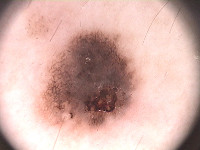</td><td>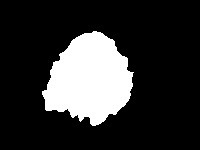</td></tr></table>

2. Разархивируем .rar файл.
3. Обратите внимание, что папка  `PH2 Dataset images` должна лежать там же где и ipynb notebook.

Это фотографии двух типов **поражений кожи:** меланома и родинки.
В данном задании мы не будем заниматься их классификацией, а будем **сегментировать** их.

In [ ]:
! wget https://www.dropbox.com/s/k88qukc20ljnbuo/PH2Dataset.rar

--2021-05-18 12:16:27--  https://www.dropbox.com/s/k88qukc20ljnbuo/PH2Dataset.rar
Resolving www.dropbox.com (www.dropbox.com)... 162.125.64.18, 2620:100:6023:18::a27d:4312
Connecting to www.dropbox.com (www.dropbox.com)|162.125.64.18|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/k88qukc20ljnbuo/PH2Dataset.rar [following]
--2021-05-18 12:16:27--  https://www.dropbox.com/s/raw/k88qukc20ljnbuo/PH2Dataset.rar
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uce081aa431b2510bbba177e1b74.dl.dropboxusercontent.com/cd/0/inline/BOt9eXirtZk60TmrRXdY-lzG-ZHBLFeV-_wZnRVVtC8AalhFvnLPp23iZbfdWm17JlzZ3vRKc0iK9RsT92x4xuKKj-3TRlZ-4CPlqtLI45vQflvih7JlSYuFLloR6MTM0Cxhu7lJL-5srpZis9aFSvKu/file# [following]
--2021-05-18 12:16:28--  https://uce081aa431b2510bbba177e1b74.dl.dropboxusercontent.com/cd/0/inline/BOt9eXirtZk60TmrRXdY-lzG-ZHBLFeV-_wZnRVVtC8AalhFvnLPp23iZbfdWm17JlzZ3vRKc0iK9RsT9

In [ ]:
get_ipython().system_raw("unrar x /content/drive/MyDrive/PH2Dataset.rar")

Стуктура датасета у нас следующая:

    IMD_002/
        IMD002_Dermoscopic_Image/
            IMD002.bmp
        IMD002_lesion/
            IMD002_lesion.bmp
        IMD002_roi/
            ...
    IMD_003/
        ...
        ...

 Здесь `X.bmp` — изображение, которое нужно сегментировать, `X_lesion.bmp` — результат сегментации.

Для загрузки датасета можно использовать skimage: [`skimage.io.imread()`](https://scikit-image.org/docs/dev/api/skimage.io.html)

In [ ]:
images = []
lesions = []
from skimage.io import imread
import os
root = 'PH2Dataset'

for root, dirs, files in os.walk(os.path.join(root, 'PH2 Dataset images')):
    if root.endswith('_Dermoscopic_Image'):
        images.append(imread(os.path.join(root, files[0])))
    if root.endswith('_lesion'):
        lesions.append(imread(os.path.join(root, files[0])))

Изображения имеют разные размеры. Давайте изменим их размер на $256\times256 $ пикселей. Для изменения размера изображений можно использовать [`skimage.transform.resize()`](https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.resize).
Эта функция также автоматически нормализует изображения в диапазоне $[0,1]$.


In [ ]:
from skimage.transform import resize
size = (256, 256)
X = [resize(x, size, mode='constant', anti_aliasing=True,) for x in images]
Y = [resize(y, size, mode='constant', anti_aliasing=False) > 0.5 for y in lesions]

In [ ]:
import numpy as np
X = np.array(X, np.float32)
Y = np.array(Y, np.float32)
print(f'Loaded {len(X)} images')

Loaded 200 images


In [ ]:
len(lesions)

200

Чтобы убедиться, что все корректно, мы нарисуем несколько изображений

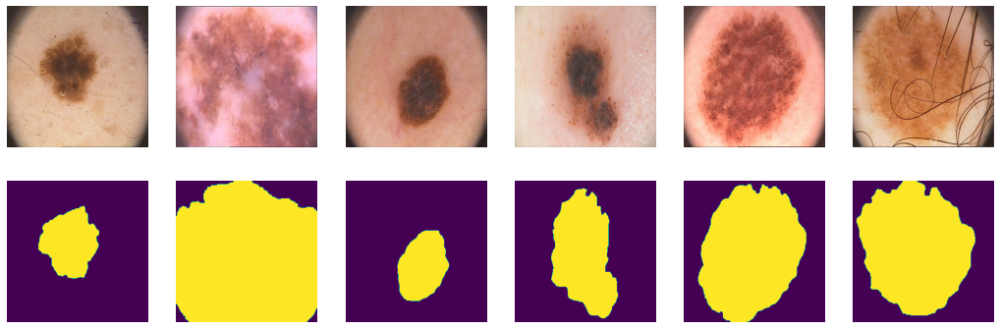

In [ ]:
import matplotlib.pyplot as plt
from IPython.display import clear_output

plt.figure(figsize=(18, 6))
for i in range(6):
    plt.subplot(2, 6, i+1)
    plt.axis("off")
    plt.imshow(X[i])

    plt.subplot(2, 6, i+7)
    plt.axis("off")
    plt.imshow(Y[i])
plt.show();

Разделим наши 200 картинок на 100/50/50
 для обучения, валидации и теста соответственно

In [ ]:
ix = np.random.choice(len(X), len(X), False)
tr, val, ts = np.split(ix, [100, 150])

In [ ]:
print(len(tr), len(val), len(ts))

100 50 50


#### PyTorch DataLoader

In [ ]:
from torch.utils.data import DataLoader
batch_size = 8
data_tr = DataLoader(list(zip(np.rollaxis(X[tr], 3, 1), Y[tr, np.newaxis])), 
                     batch_size=batch_size, shuffle=True, drop_last = True)
data_val = DataLoader(list(zip(np.rollaxis(X[val], 3, 1), Y[val, np.newaxis])),
                      batch_size=batch_size, shuffle=False, drop_last = True)
data_ts = DataLoader(list(zip(np.rollaxis(X[ts], 3, 1), Y[ts, np.newaxis])),
                     batch_size=batch_size, shuffle=False, drop_last = True)

In [ ]:
import torch
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


# Реализация различных архитектур:
Ваше задание будет состоять в том, чтобы написать несколько нейросетевых архитектур для решения задачи семантической сегментации. Сравнить их по качеству на тесте и испробовать различные лосс функции для них.

-----------------------------------------------------------------------------------------

# SegNet [2 балла]

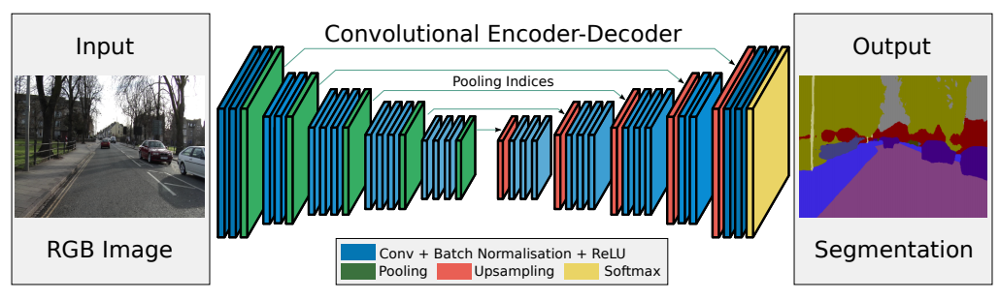

* Badrinarayanan, V., Kendall, A., & Cipolla, R. (2015). [SegNet: A deep convolutional
encoder-decoder architecture for image segmentation](https://arxiv.org/pdf/1511.00561.pdf)

Внимательно посмотрите из чего состоит модель и для чего выбраны те или иные блоки.

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import models
import torch.optim as optim
from time import time
import torchvision

from matplotlib import rcParams
rcParams['figure.figsize'] = (15,4)

In [ ]:
class SegNet(nn.Module):
    def __init__(self):
        super().__init__()

        self.enc_conv0 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU()
        )
        self.pool0 = nn.MaxPool2d(kernel_size=2, stride=2, padding=0, return_indices = True)
        
        self.enc_conv1 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU()
        )
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2, padding=0, return_indices = True)
        
        self.enc_conv2 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU()
        )
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2, padding=0, return_indices = True)
        
        self.enc_conv3 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU()
        )
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2, padding=0, return_indices = True)

        self.enc_conv4 = nn.Sequential(
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU()
        )
        self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2, padding=0, return_indices = True)
        
        self.upsample0 = nn.MaxUnpool2d(kernel_size = 2, stride = 2, padding = 0)
        self.dec_conv0 = nn.Sequential(
            nn.ConvTranspose2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU()
        )

        # decoder (upsampling)
        self.upsample1 = nn.MaxUnpool2d(kernel_size = 2, stride = 2, padding = 0)
        self.dec_conv1 = nn.Sequential(
            nn.ConvTranspose2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU()
        )

        self.upsample2 = nn.MaxUnpool2d(kernel_size = 2, stride = 2, padding = 0)
        self.dec_conv2 = nn.Sequential(
            nn.ConvTranspose2d(in_channels=256, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=256, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU()
        )

        self.upsample3 = nn.MaxUnpool2d(kernel_size = 2, stride = 2, padding = 0)
        self.dec_conv3 = nn.Sequential(
            nn.ConvTranspose2d(in_channels=128, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU()
        )
        self.upsample4 = nn.MaxUnpool2d(kernel_size = 2, stride = 2, padding = 0)
        self.dec_conv4 =nn.Sequential(
            nn.ConvTranspose2d(in_channels=64, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=64, out_channels=1, kernel_size=3, padding=1)
        )

    def forward(self, x):
        # encoder
        e0 = self.pool0(self.enc_conv0(x))
        e1 = self.pool1(self.enc_conv1(e0[0]))
        e2 = self.pool2(self.enc_conv2(e1[0]))
        e3 = self.pool3(self.enc_conv3(e2[0]))
        e4 = self.pool4(self.enc_conv4(e3[0]))

        # decoder
        d0 = self.dec_conv0(self.upsample0(e4[0], e4[1]))
        d1 = self.dec_conv1(self.upsample1(d0, e3[1]))
        d2 = self.dec_conv2(self.upsample2(d1, e2[1]))
        d3 = self.dec_conv3(self.upsample3(d2, e1[1]))
        d4 = self.dec_conv4(self.upsample4(d3, e0[1]))

        return d4

## Метрика

В данном разделе предлагается использовать следующую метрику для оценки качества:

$I o U=\frac{\text {target } \cap \text { prediction }}{\text {target } \cup{prediction }}$

Пересечение (A ∩ B) состоит из пикселей, найденных как в маске предсказания, так и в основной маске истины, тогда как объединение (A ∪ B) просто состоит из всех пикселей, найденных либо в маске предсказания, либо в целевой маске.


Для примера посмотрим на истину (слева) и предсказание (справа):
![alt text](https://www.jeremyjordan.me/content/images/2018/05/target_prediction.png)


Тогда пересечение и объединение будет выглядеть так:

![alt text](https://www.jeremyjordan.me/content/images/2018/05/intersection_union.png)

In [ ]:
def iou_pytorch(outputs: torch.Tensor, labels: torch.Tensor):
    # You can comment out this line if you are passing tensors of equal shape
    # But if you are passing output from UNet or something it will most probably
    # be with the BATCH x 1 x H x W shape
    outputs = outputs.squeeze(1).byte()  # BATCH x 1 x H x W => BATCH x H x W
    labels = labels.squeeze(1).byte()
    SMOOTH = 1e-8
    intersection = (outputs & labels).float().sum((1, 2))  # Will be zero if Truth=0 or Prediction=0
    union = (outputs | labels).float().sum((1, 2))         # Will be zzero if both are 0
    
    iou = (intersection + SMOOTH) / (union + SMOOTH)  # We smooth our devision to avoid 0/0
    
    thresholded = torch.clamp(20 * (iou - 0.5), 0, 10).ceil() / 10  # This is equal to comparing with thresolds
    
    return thresholded  # 

## Функция потерь [1 балл]

Не менее важным, чем построение архитектуры, является определение **оптимизатора** и **функции потерь.**

Функция потерь - это то, что мы пытаемся минимизировать. Многие из них могут быть использованы для задачи бинарной семантической сегментации. 

Популярным методом для бинарной сегментации является *бинарная кросс-энтропия*, которая задается следующим образом:

$$\mathcal L_{BCE}(y, \hat y) = -\sum_i \left[y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

где $y$ это  таргет желаемого результата и $\hat y$ является выходом модели. $\sigma$ - это [*логистическая* функция](https://en.wikipedia.org/wiki/Sigmoid_function), который преобразует действительное число $\mathbb R$ в вероятность $[0,1]$.

Однако эта потеря страдает от проблем численной нестабильности. Самое главное, что $\lim_{x\rightarrow0}\log(x)=\infty$ приводит к неустойчивости в процессе оптимизации. Рекомендуется посмотреть следующее [упрощение](https://www.tensorflow.org/api_docs/python/tf/nn/sigmoid_cross_entropy_with_logits). Эта функция эквивалентна первой и не так подвержена численной неустойчивости:

$$\mathcal L_{BCE} = \hat y - y\hat y + \log\left(1+\exp(-\hat y)\right).$$

In [ ]:
def bce_loss(y_pred, y_real):
    return (torch.max(y_pred, torch.zeros(y_pred.shape, device = device)) - y_pred * y_real + torch.log(1 + torch.exp(-torch.abs(y_pred)))).mean()

## Тренировка [1 балл]

Мы определим цикл обучения в функции, чтобы мы могли повторно использовать его.

In [ ]:
def fit_epoch(model, train_loader, criterion, optimizer, metric, device):
    model.train()
    running_loss = 0.0
    running_iou = 0.0

    for inputs, labels in train_loader:
        inputs = inputs.to(device)
        labels = labels.to(device)
        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        
        preds = torch.round(torch.sigmoid(outputs))
        iou = metric(preds, labels)
        
        running_iou += iou
        
        running_loss += loss.item() 
    
    processed_data = len(train_loader)
              
    train_loss = running_loss / processed_data
    train_iou =  (running_iou / processed_data).mean()
    
    return train_loss, train_iou

In [ ]:
def eval_epoch(model, val_loader, criterion, metric, device):
    model.eval()
    running_loss = 0.0
    running_iou = 0.0

    for inputs, labels in val_loader:
        inputs = inputs.to(device)
        labels = labels.to(device)

        with torch.set_grad_enabled(False):
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            
        preds = torch.round(torch.sigmoid(outputs))
        iou = metric(preds, labels)
        
        running_iou += iou

        running_loss += loss.item()

    
    processed_data = len(val_loader)

    val_loss = running_loss / processed_data
    val_iou = (running_iou / processed_data).mean()
    
    return val_loss, val_iou

In [ ]:
from tqdm.notebook import tqdm


def train(model, optimizer, criterion, epochs, train_loader, val_loader, metric, device):
    model.to(device)
    X_val, Y_val = next(iter(val_loader))
    history = []
    for epoch in tqdm(range(epochs)):
        print('* Epoch %d/%d' % (epoch+1, epochs))
        train_loss, train_iou = fit_epoch(model, train_loader, criterion, optimizer, metric, device)
        print('Train_loss: %f, train_iou: %f' % (train_loss, train_iou))
        val_loss, val_iou = eval_epoch(model, val_loader, criterion, metric, device)
        print('Val_loss: %f, val_iou: %f' % (val_loss, val_iou))


        model.eval()
        Y_hat = model((X_val).to(device)).to('cpu').detach().numpy()

        # Visualize tools
        for k in range(6):
            plt.subplot(2, 6, k+1)
            plt.imshow(np.rollaxis(X_val[k].numpy(), 0, 3), cmap='gray')
            plt.title('Real')
            plt.axis('off')


            plt.subplot(2, 6, k+7)
            plt.imshow(Y_hat[k, 0], cmap='gray')
            plt.title('Output')
            plt.axis('off')
            
        plt.show()

        history.append((train_loss, train_iou,val_loss, val_iou))
    
    return history


## Инференс [1 балл]

После обучения модели эту функцию можно использовать для прогнозирования сегментации на новых данных:

In [ ]:
def score_model(model, metric, data):
    model.eval()  # testing mode
    scores = 0
    for X_batch, Y_label in data:
        X_batch = X_batch.to(device)
        Y_label = Y_label.to(device)
        Y_pred = torch.round(torch.sigmoid(model(X_batch)))
        scores += metric(Y_pred, Y_label).mean()

    return scores/len(data)

## Основной момент: обучение

Обучите вашу модель. Обратите внимание, что обучать необходимо до сходимости. Если указанного количества эпох (20) не хватило, попробуйте изменять количество эпох до сходимости алгоритма. Сходимость определяйте по изменению функции потерь на валидационной выборке.
 С параметрами оптимизатора можно спокойно играть, пока вы не найдете лучший вариант для себя.


* Epoch 1/20
Train_loss: 1.077084, train_iou: 0.030208
Val_loss: 0.699995, val_iou: 0.006250


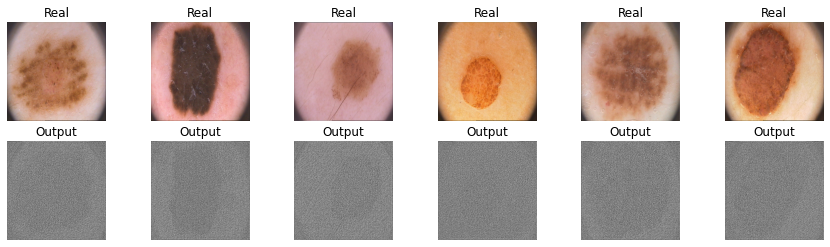

* Epoch 2/20
Train_loss: 0.675562, train_iou: 0.050000
Val_loss: 0.667080, val_iou: 0.000000


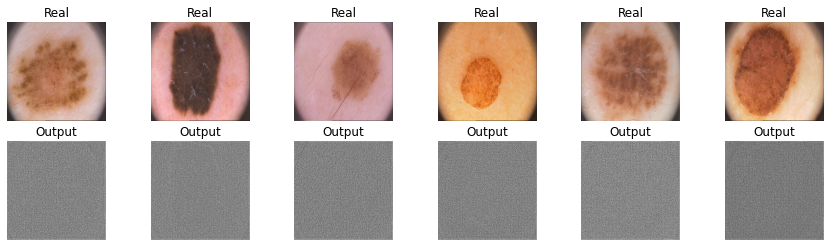

* Epoch 3/20
Train_loss: 0.540185, train_iou: 0.098958
Val_loss: 0.609119, val_iou: 0.000000


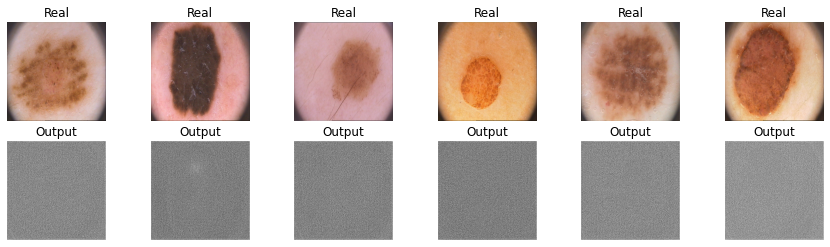

* Epoch 4/20
Train_loss: 0.442921, train_iou: 0.208333
Val_loss: 0.498028, val_iou: 0.035417


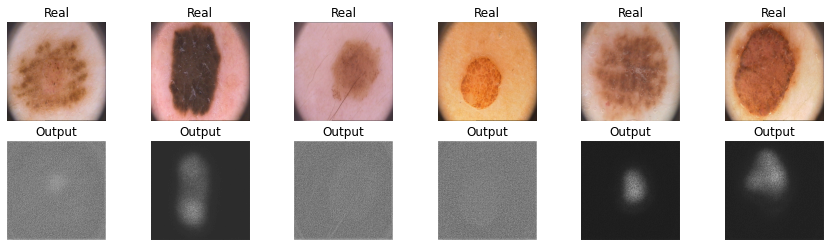

* Epoch 5/20
Train_loss: 0.379382, train_iou: 0.364583
Val_loss: 0.531366, val_iou: 0.000000


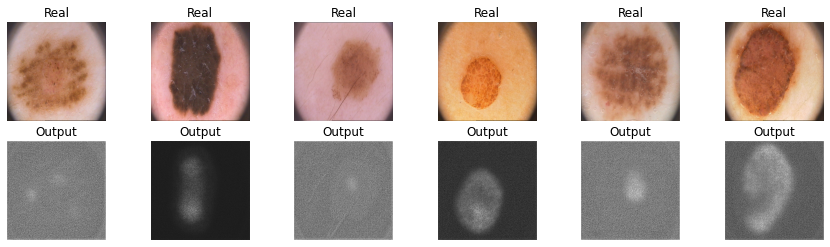

* Epoch 6/20
Train_loss: 0.307622, train_iou: 0.446875
Val_loss: 0.365420, val_iou: 0.187500


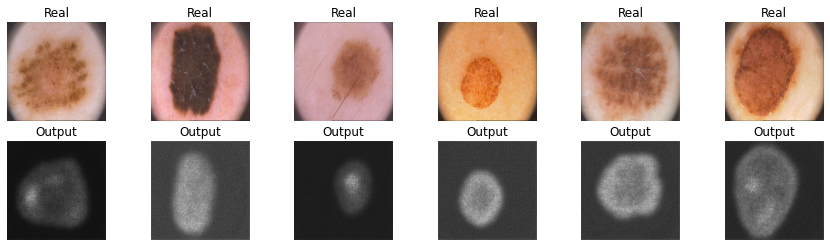

* Epoch 7/20
Train_loss: 0.285105, train_iou: 0.465625
Val_loss: 0.374062, val_iou: 0.039583


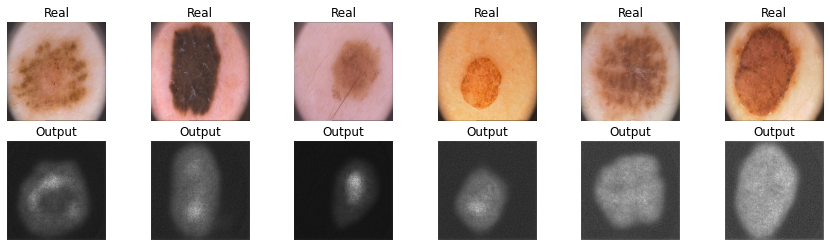

* Epoch 8/20
Train_loss: 0.266932, train_iou: 0.477083
Val_loss: 0.253398, val_iou: 0.443750


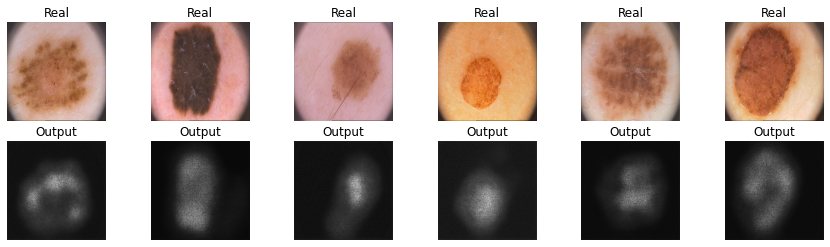

* Epoch 9/20
Train_loss: 0.231558, train_iou: 0.552083
Val_loss: 0.216496, val_iou: 0.562500


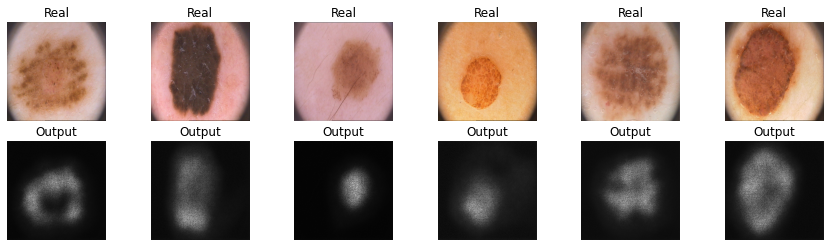

* Epoch 10/20
Train_loss: 0.284892, train_iou: 0.544792
Val_loss: 0.240363, val_iou: 0.497917


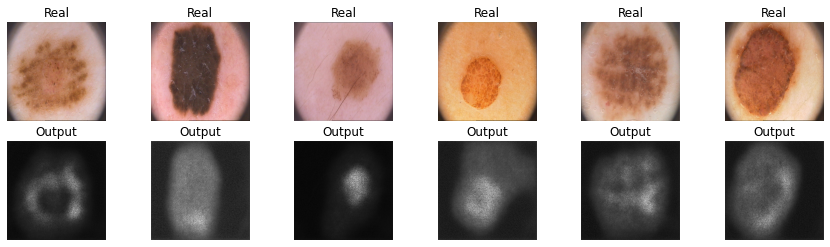

* Epoch 11/20
Train_loss: 0.217383, train_iou: 0.561458
Val_loss: 0.233208, val_iou: 0.529167


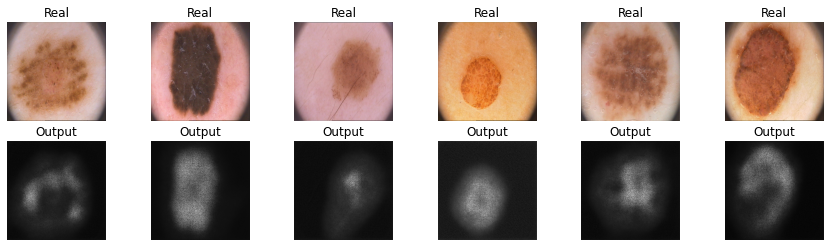

* Epoch 12/20
Train_loss: 0.249100, train_iou: 0.536458
Val_loss: 0.209880, val_iou: 0.489583


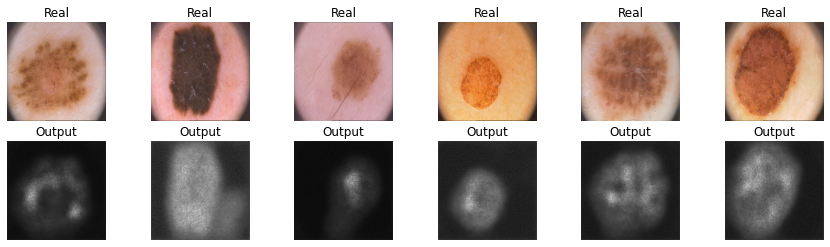

* Epoch 13/20
Train_loss: 0.208818, train_iou: 0.583333
Val_loss: 0.185799, val_iou: 0.602083


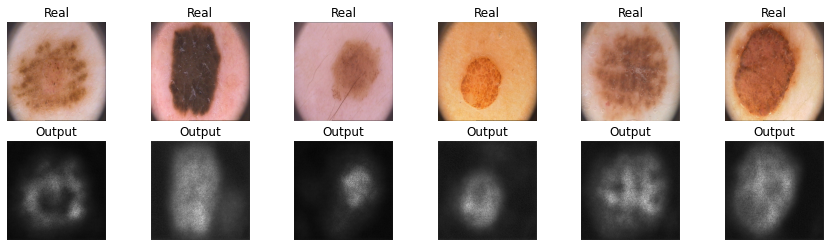

* Epoch 14/20
Train_loss: 0.169012, train_iou: 0.639583
Val_loss: 0.195377, val_iou: 0.616667


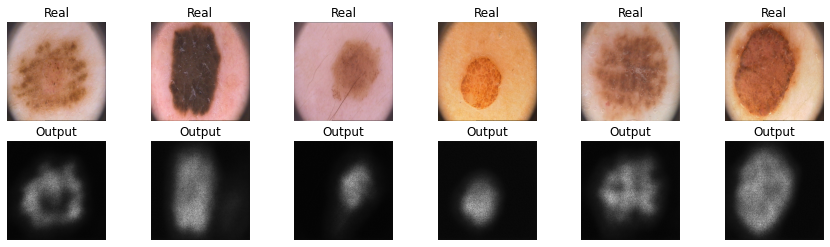

* Epoch 15/20
Train_loss: 0.157956, train_iou: 0.643750
Val_loss: 0.219023, val_iou: 0.568750


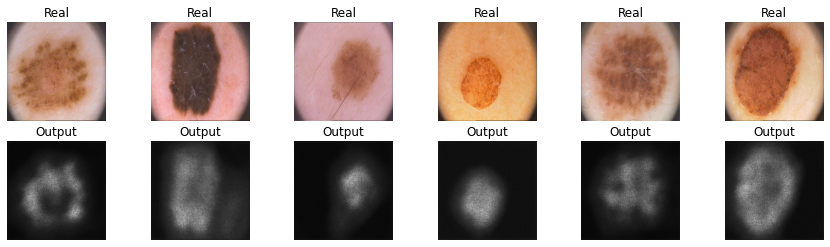

* Epoch 16/20
Train_loss: 0.192818, train_iou: 0.639583
Val_loss: 0.213073, val_iou: 0.541667


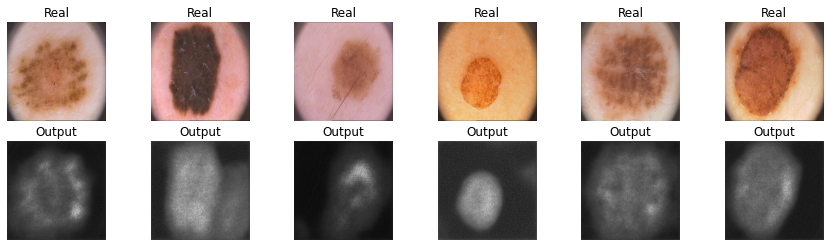

* Epoch 17/20
Train_loss: 0.183658, train_iou: 0.632292
Val_loss: 0.179720, val_iou: 0.635417


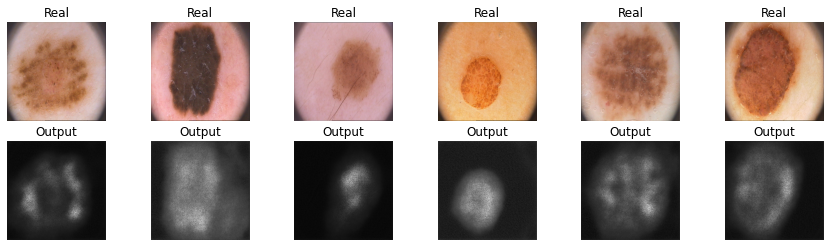

* Epoch 18/20
Train_loss: 0.193919, train_iou: 0.607292
Val_loss: 0.168173, val_iou: 0.606250


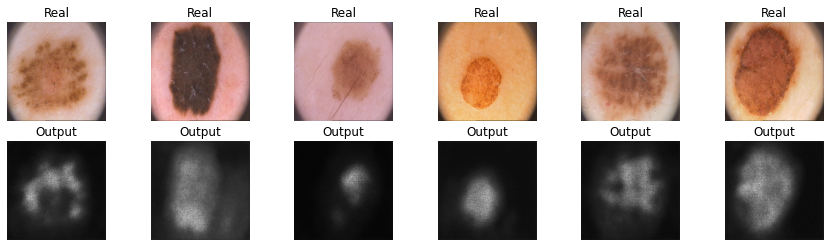

* Epoch 19/20
Train_loss: 0.159794, train_iou: 0.658333
Val_loss: 0.195088, val_iou: 0.637500


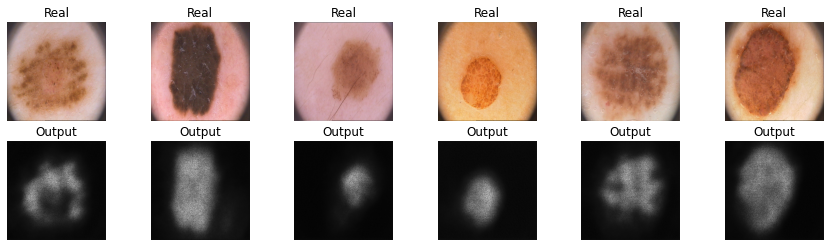

* Epoch 20/20
Train_loss: 0.139237, train_iou: 0.702083
Val_loss: 0.184042, val_iou: 0.612500


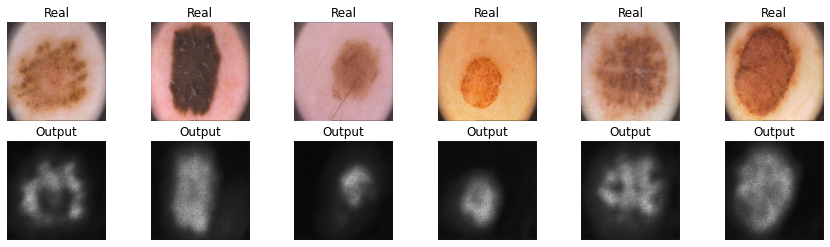

In [ ]:
epochs = 20

segnet_bce = SegNet()

segnet_bce_optimizer = torch.optim.Adam(segnet_bce.parameters(),lr=0.00004)

history_segnet_bce_loss = train(segnet_bce, segnet_bce_optimizer, bce_loss, epochs, data_tr, data_val, iou_pytorch, device)

In [ ]:
score_model(segnet_bce, iou_pytorch, data_ts)

tensor(0.7146, device='cuda:0')

-----------------------------------------------------------------------------------------

## Дополнительные функции потерь [2 балла] 

 В данном разделе вам потребуется имплементировать две функции потерь:
 DICE и Focal loss. 
 Если у вас что-то не учится, велика вероятность, что вы ошиблись или учите слишком мало эпох, прежде чем бить тревогу попробуйте перебрать различные варианты и убедитесь, что во всех других сетапах сеть достигает желанного результата. СПОЙЛЕР: учиться она будет при всех лоссах, предложенных в этом задании.


**1. Dice coefficient:** Учитывая две маски $X$ и $Y$, общая метрика для измерения расстояния между этими двумя масками задается следующим образом:

$$D(X,Y)=\frac{2|X\cap Y|}{|X|+|Y|}$$

Эта функция не является дифференцируемой, но это необходимое свойство для градиентного спуска. В данном случае мы можем приблизить его с помощью:

$$\mathcal L_D(X,Y) = 1-\frac{1}{256 \times 256} \times \sum_i\frac{2X_iY_i}{X_i+Y_i}.$$

Не забудьте подумать о численной нестабильности, возникающей в математической формуле.


In [ ]:
def dice_loss(y_pred, y_real):
        smooth=1e-8
        y_pred = torch.sigmoid(y_pred)       
        
        y_pred = y_pred.view(-1)
        y_real = y_real.view(-1)
        
        intersection = (y_pred * y_real).sum()                            
        dice = (2.*intersection + smooth)/(y_pred.sum() + y_real.sum() + smooth)  
        
        return 1 - dice

Проводим тестирование:

* Epoch 1/20
Train_loss: 0.679844, train_iou: 0.001042
Val_loss: 0.661876, val_iou: 0.000000


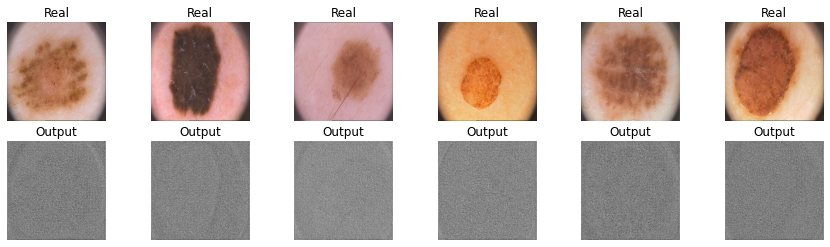

* Epoch 2/20
Train_loss: 0.537103, train_iou: 0.102083
Val_loss: 0.624537, val_iou: 0.027083


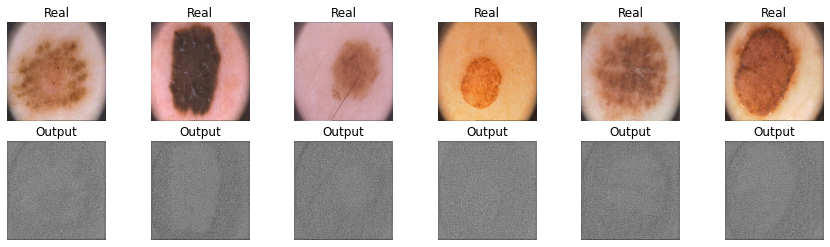

* Epoch 3/20
Train_loss: 0.447398, train_iou: 0.131250
Val_loss: 0.576695, val_iou: 0.043750


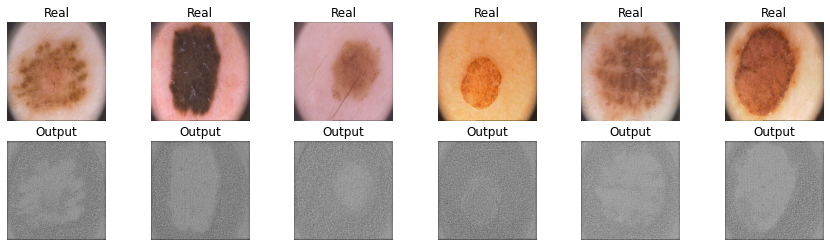

* Epoch 4/20
Train_loss: 0.319747, train_iou: 0.275000
Val_loss: 0.558485, val_iou: 0.043750


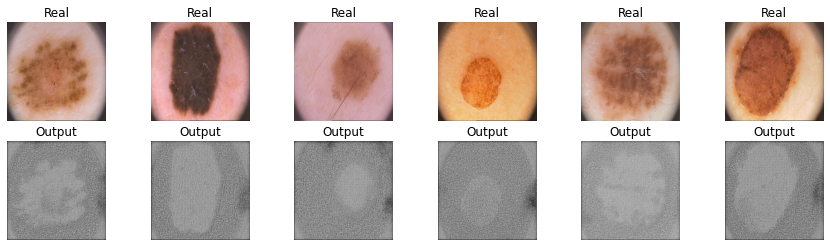

* Epoch 5/20
Train_loss: 0.209556, train_iou: 0.398958
Val_loss: 0.313948, val_iou: 0.279167


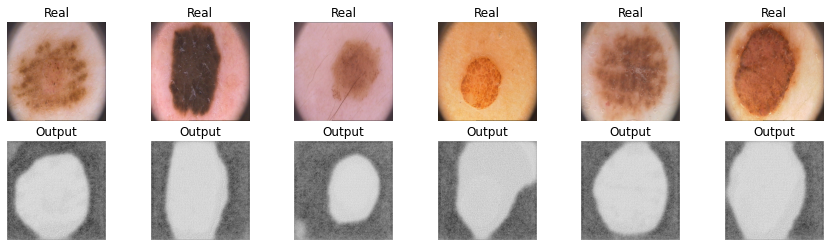

* Epoch 6/20
Train_loss: 0.190713, train_iou: 0.463542
Val_loss: 0.435416, val_iou: 0.116667


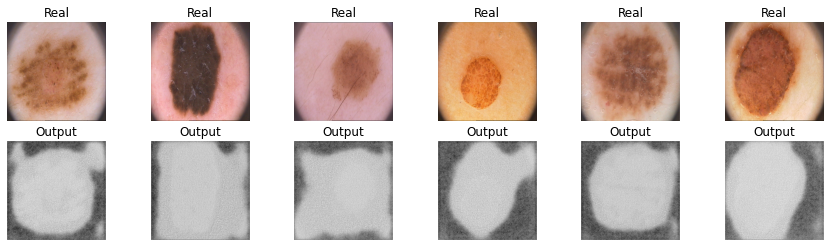

* Epoch 7/20
Train_loss: 0.156148, train_iou: 0.531250
Val_loss: 0.168604, val_iou: 0.468750


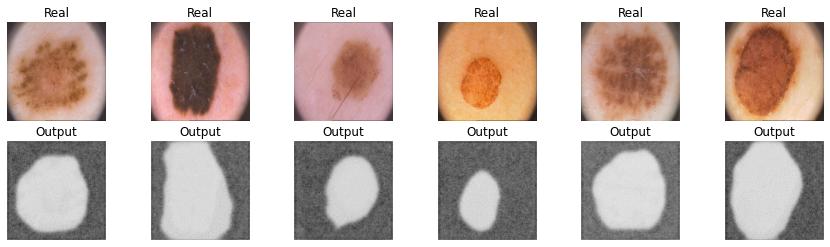

* Epoch 8/20
Train_loss: 0.148794, train_iou: 0.577083
Val_loss: 0.130837, val_iou: 0.593750


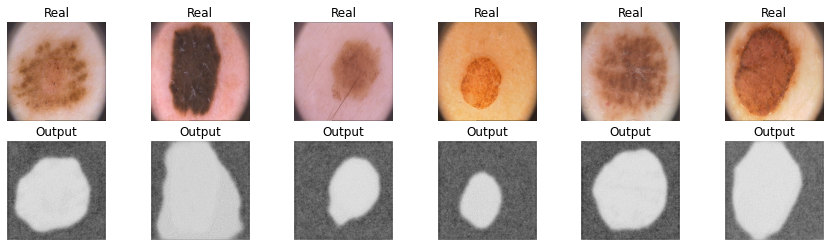

* Epoch 9/20
Train_loss: 0.144713, train_iou: 0.571875
Val_loss: 0.131645, val_iou: 0.572917


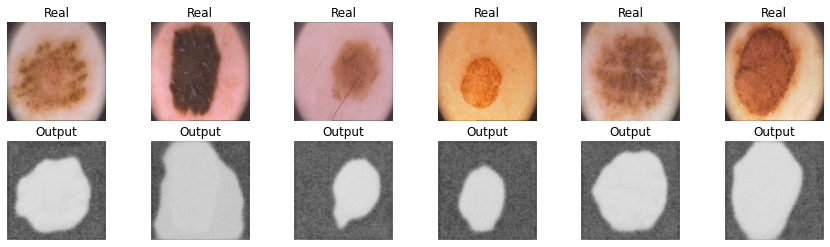

* Epoch 10/20
Train_loss: 0.124622, train_iou: 0.619792
Val_loss: 0.113832, val_iou: 0.635417


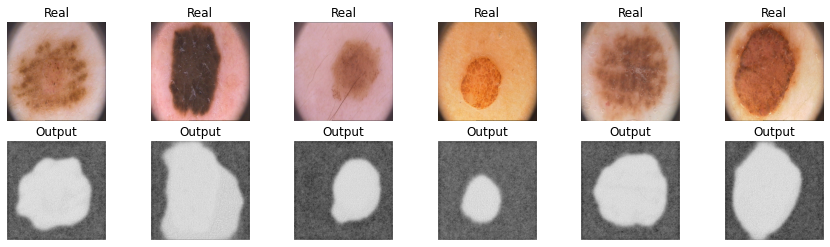

* Epoch 11/20
Train_loss: 0.114665, train_iou: 0.651042
Val_loss: 0.161966, val_iou: 0.483333


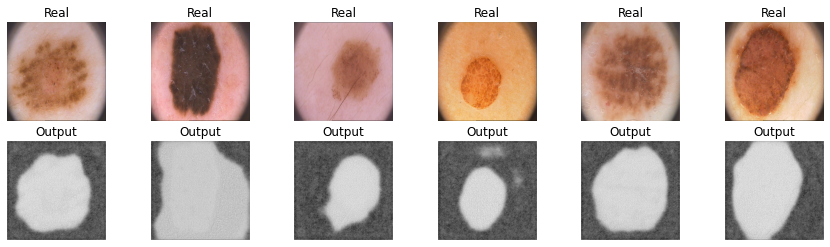

* Epoch 12/20
Train_loss: 0.122913, train_iou: 0.658333
Val_loss: 0.123333, val_iou: 0.608333


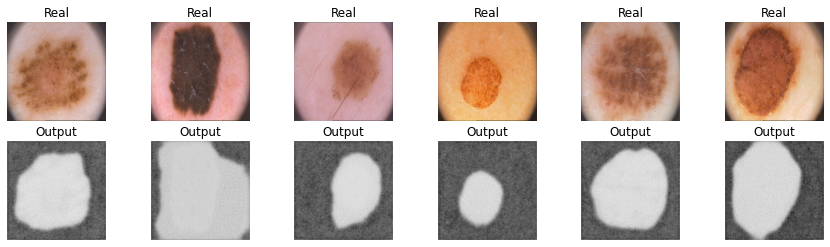

* Epoch 13/20
Train_loss: 0.141588, train_iou: 0.596875
Val_loss: 0.127835, val_iou: 0.566667


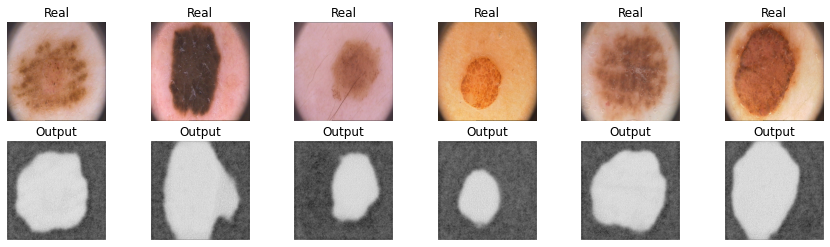

* Epoch 14/20
Train_loss: 0.132547, train_iou: 0.630208
Val_loss: 0.107808, val_iou: 0.639583


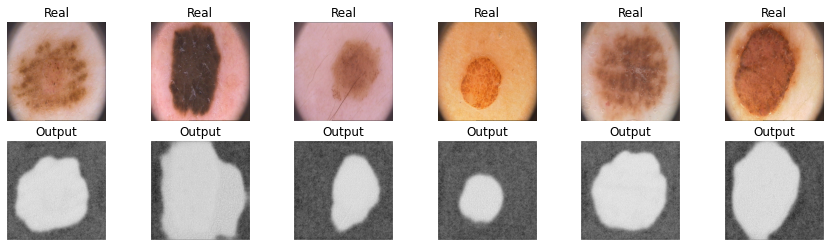

* Epoch 15/20
Train_loss: 0.129362, train_iou: 0.638542
Val_loss: 0.121470, val_iou: 0.612500


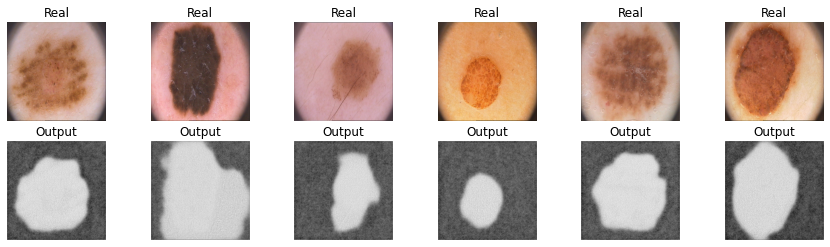

* Epoch 16/20
Train_loss: 0.119856, train_iou: 0.652083
Val_loss: 0.167825, val_iou: 0.483333


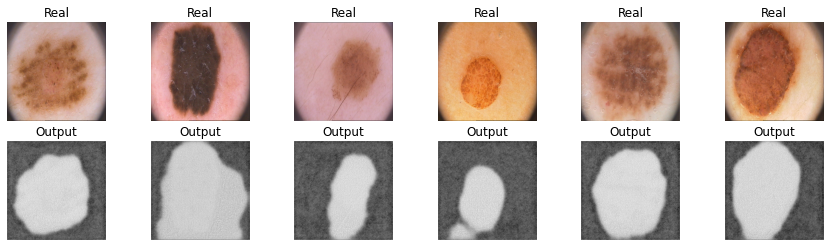

* Epoch 17/20
Train_loss: 0.113812, train_iou: 0.635417
Val_loss: 0.139740, val_iou: 0.620833


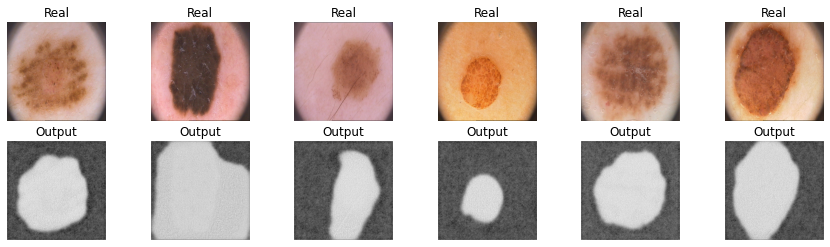

* Epoch 18/20
Train_loss: 0.090716, train_iou: 0.704167
Val_loss: 0.147352, val_iou: 0.539583


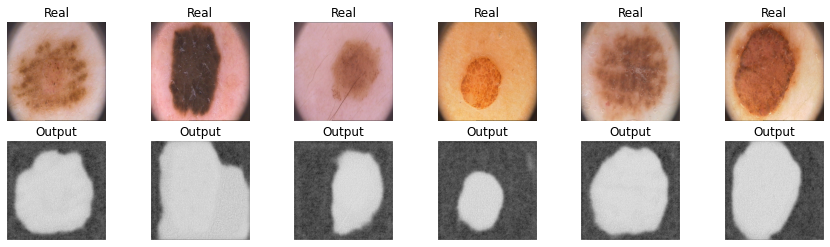

* Epoch 19/20
Train_loss: 0.106193, train_iou: 0.711458
Val_loss: 0.106881, val_iou: 0.650000


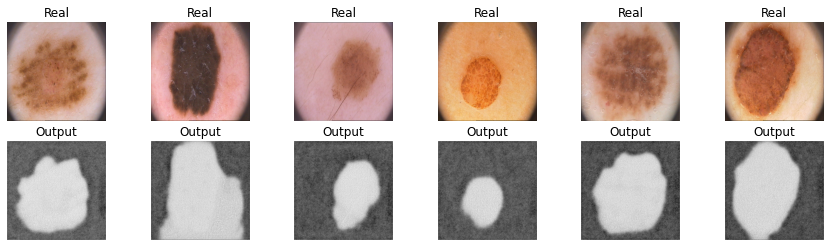

* Epoch 20/20
Train_loss: 0.101243, train_iou: 0.694792
Val_loss: 0.097293, val_iou: 0.693750


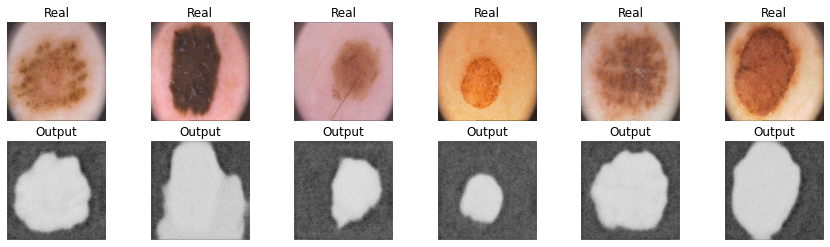

In [ ]:
epochs = 20

segnet_dice = SegNet()

segnet_dice_optimizer = torch.optim.Adam(segnet_dice.parameters(),lr=0.00004)

history_segnet_dice_loss = train(segnet_dice, segnet_dice_optimizer, dice_loss, epochs, data_tr, data_val, iou_pytorch, device)

In [ ]:
score_model(segnet_dice, iou_pytorch, data_ts)

tensor(0.7500, device='cuda:0')

[**2. Focal loss:**](https://arxiv.org/pdf/1708.02002.pdf) 

Окей, мы уже с вами умеем делать BCE loss:

$$\mathcal L_{BCE}(y, \hat y) = -\sum_i \left[y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

Проблема с этой потерей заключается в том, что она имеет тенденцию приносить пользу классу **большинства** (фоновому) по отношению к классу **меньшинства** ( переднему). Поэтому обычно применяются весовые коэффициенты к каждому классу:

$$\mathcal L_{wBCE}(y, \hat y) = -\sum_i \alpha_i\left[y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

Традиционно вес $\alpha_i$ определяется как обратная частота класса этого пикселя $i$, так что наблюдения миноритарного класса весят больше по отношению к классу большинства.

Еще одним недавним дополнением является взвешенный пиксельный вариант, которая взвешивает каждый пиксель по степени уверенности, которую мы имеем в предсказании этого пикселя.

$$\mathcal L_{focal}(y, \hat y) = -\sum_i \left[\left(1-\sigma(\hat y_i)\right)^\gamma y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

Зафиксируем значение $\gamma=2$.

--------------------------------------------------------------------------------


In [ ]:
def focal_loss(y_pred, y_real, gamma = 2):
    bce_loss = torch.max(y_pred, torch.zeros(y_pred.shape, device = device)) - y_pred * y_real + torch.log(1 + torch.exp(-torch.abs(y_pred)))
    pt = torch.exp(-bce_loss)
    F_loss = (1-pt)**gamma * bce_loss
    return F_loss.mean()


* Epoch 1/20
Train_loss: 0.592124, train_iou: 0.002083
Val_loss: 0.229921, val_iou: 0.043750


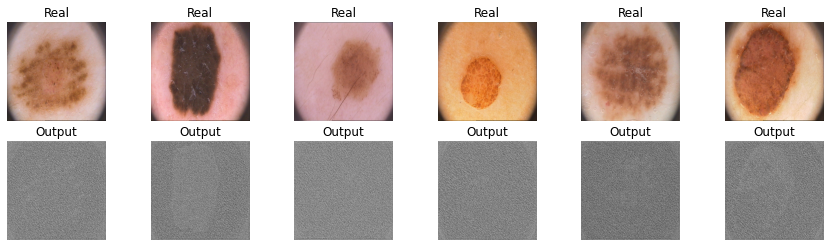

* Epoch 2/20
Train_loss: 0.398252, train_iou: 0.001042
Val_loss: 0.203768, val_iou: 0.022917


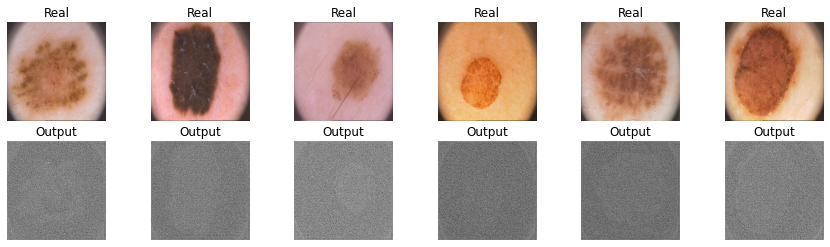

* Epoch 3/20
Train_loss: 0.349096, train_iou: 0.005208
Val_loss: 0.187654, val_iou: 0.006250


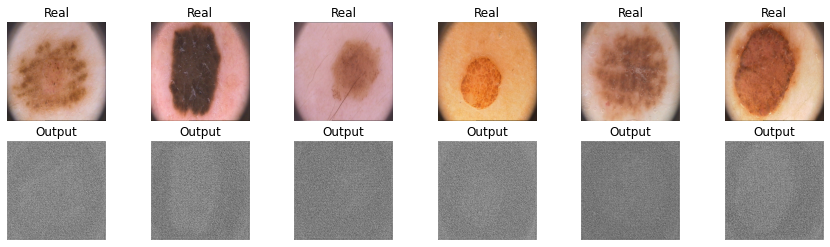

* Epoch 4/20
Train_loss: 0.230467, train_iou: 0.001042
Val_loss: 0.168983, val_iou: 0.000000


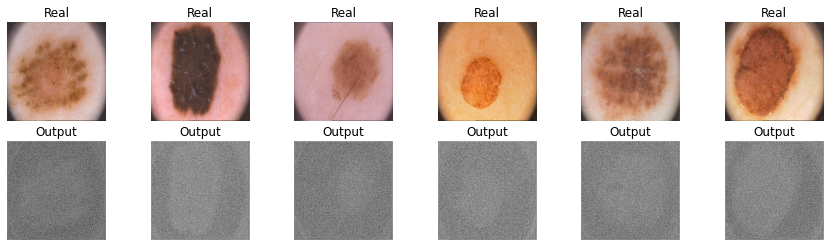

* Epoch 5/20
Train_loss: 0.165657, train_iou: 0.010417
Val_loss: 0.153035, val_iou: 0.000000


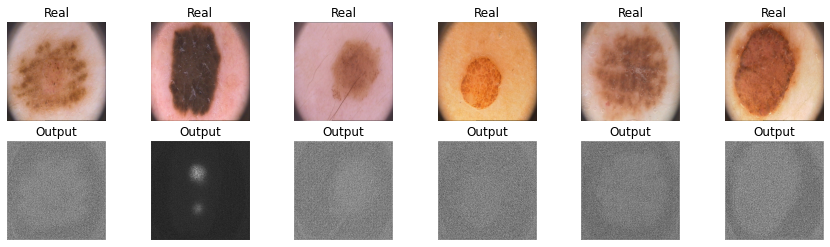

* Epoch 6/20
Train_loss: 0.166698, train_iou: 0.018750
Val_loss: 0.147336, val_iou: 0.012500


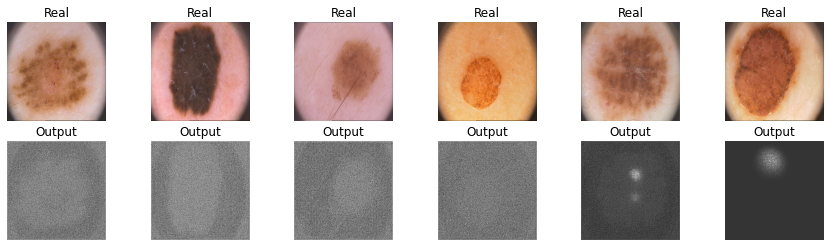

* Epoch 7/20
Train_loss: 0.150239, train_iou: 0.030208
Val_loss: 0.146851, val_iou: 0.000000


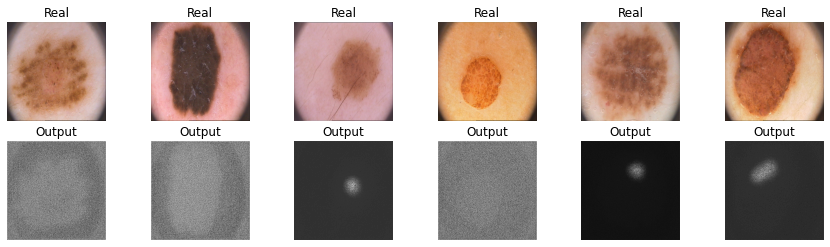

* Epoch 8/20
Train_loss: 0.149310, train_iou: 0.036458
Val_loss: 0.132622, val_iou: 0.027083


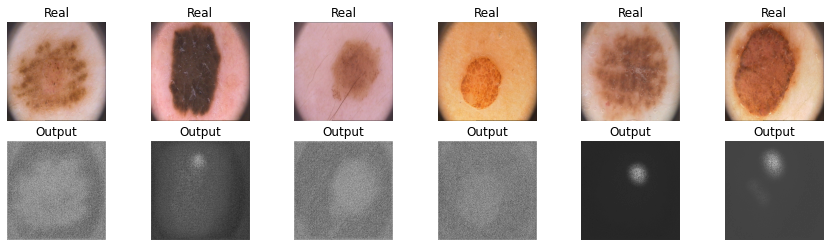

* Epoch 9/20
Train_loss: 0.131627, train_iou: 0.054167
Val_loss: 0.116956, val_iou: 0.016667


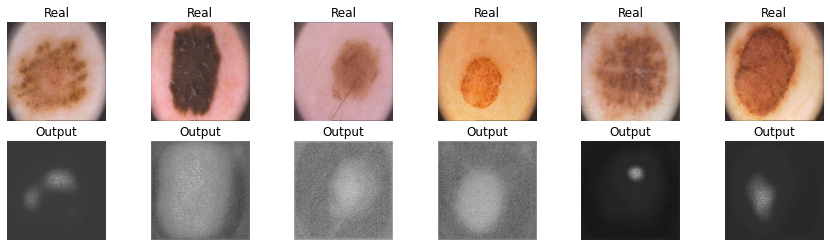

* Epoch 10/20
Train_loss: 0.109891, train_iou: 0.132292
Val_loss: 0.135947, val_iou: 0.177083


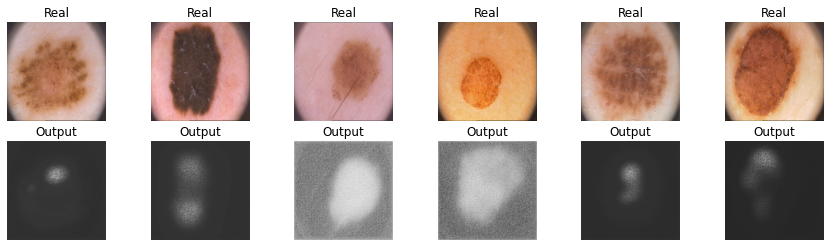

* Epoch 11/20
Train_loss: 0.089279, train_iou: 0.329167
Val_loss: 0.095650, val_iou: 0.366667


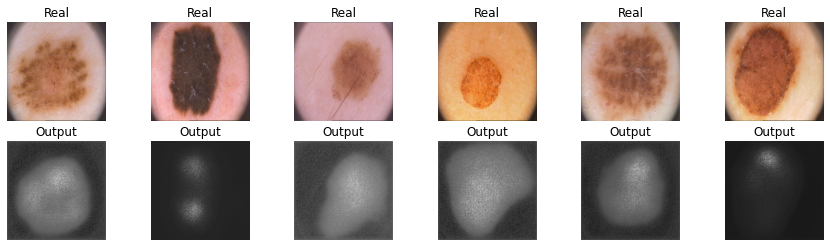

* Epoch 12/20
Train_loss: 0.085013, train_iou: 0.423958
Val_loss: 0.072582, val_iou: 0.302083


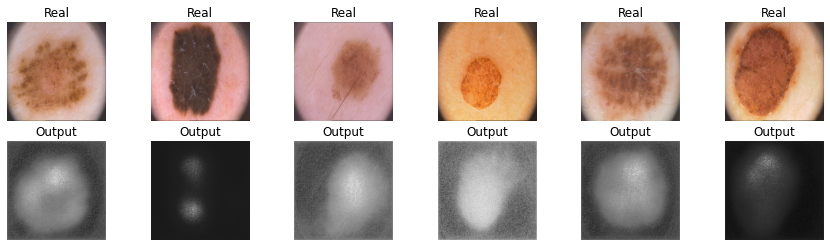

* Epoch 13/20
Train_loss: 0.084290, train_iou: 0.364583
Val_loss: 0.064672, val_iou: 0.454167


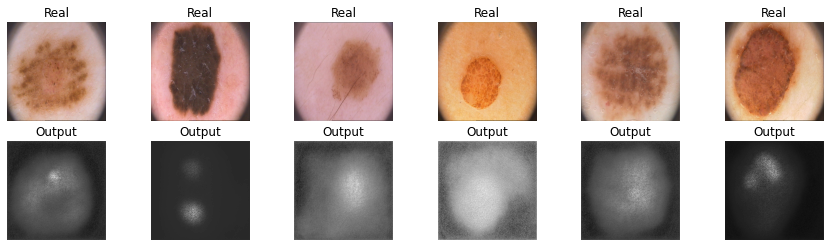

* Epoch 14/20
Train_loss: 0.070172, train_iou: 0.479167
Val_loss: 0.065916, val_iou: 0.502083


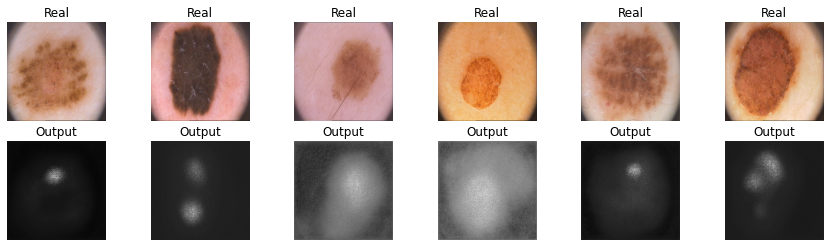

* Epoch 15/20
Train_loss: 0.058715, train_iou: 0.553125
Val_loss: 0.059772, val_iou: 0.512500


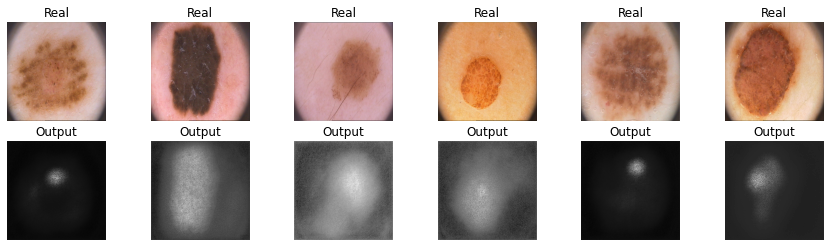

* Epoch 16/20
Train_loss: 0.078777, train_iou: 0.477083
Val_loss: 0.061378, val_iou: 0.502083


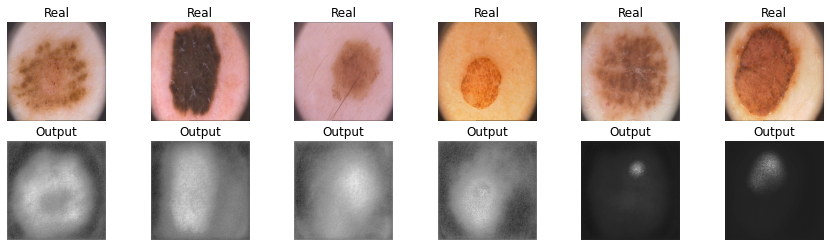

* Epoch 17/20
Train_loss: 0.064775, train_iou: 0.498958
Val_loss: 0.051986, val_iou: 0.575000


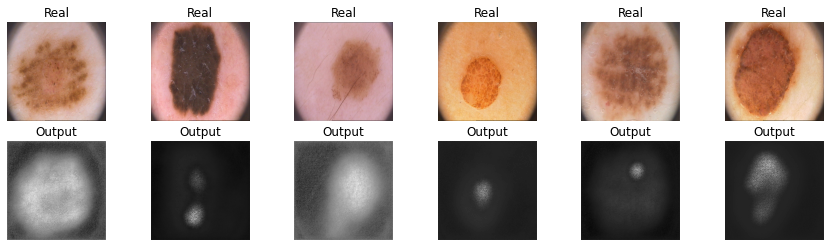

* Epoch 18/20
Train_loss: 0.055922, train_iou: 0.586458
Val_loss: 0.064938, val_iou: 0.547917


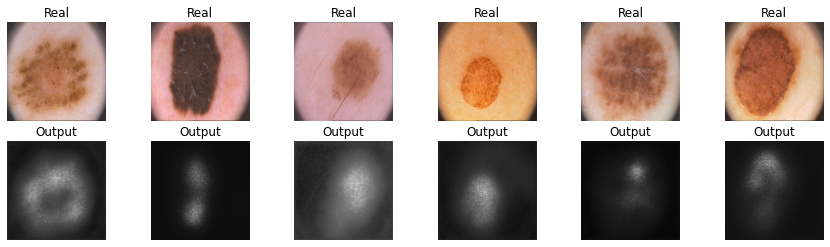

* Epoch 19/20
Train_loss: 0.056454, train_iou: 0.579167
Val_loss: 0.052084, val_iou: 0.541667


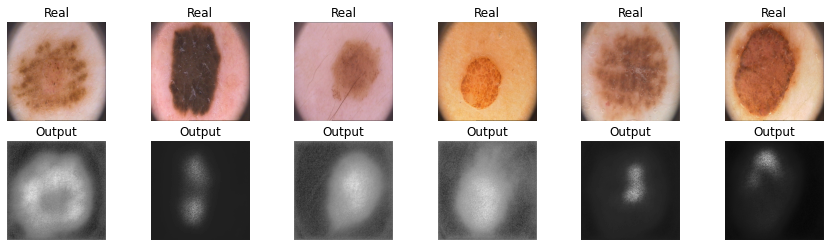

* Epoch 20/20
Train_loss: 0.049569, train_iou: 0.601042
Val_loss: 0.048980, val_iou: 0.550000


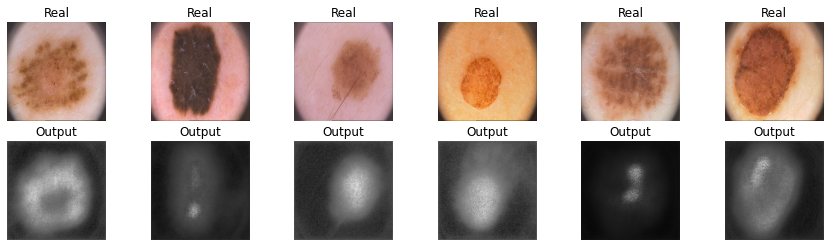

In [ ]:
epochs = 20

segnet_focal = SegNet()

segnet_focal_optimizer = torch.optim.Adam(segnet_focal.parameters(),lr=0.00004)

history_segnet_focal_loss = train(segnet_focal, segnet_focal_optimizer, focal_loss, epochs, data_tr, data_val, iou_pytorch, device)

In [ ]:
score_model(segnet_focal, iou_pytorch, data_ts)

tensor(0.5688, device='cuda:0')

----------------------------------------------------------------------------------------------

## [BONUS] Мир сегментационных лоссов [5 баллов]

В данном блоке предлагаем вам написать одну функцию потерь самостоятельно. Для этого необходимо прочитать статью и имплементировать ее. Кроме тако провести численное сравнение с предыдущими функциями.
Какие варианты? 

1) Можно учесть Total Variation
2) Lova
3) BCE но с Soft Targets (что-то типа label-smoothing для многослассовой классификации)
4) Любой другой 

* [Physiological Inspired Deep Neural Networks for Emotion Recognition](https://ieeexplore.ieee.org/stamp/stamp.jsp?arnumber=8472816&tag=1)". IEEE Access, 6, 53930-53943.

* [Boundary loss for highly unbalanced segmentation](https://arxiv.org/abs/1812.07032)

* [Tversky loss function for image segmentation using 3D fully convolutional deep networks](https://arxiv.org/abs/1706.05721)

* [Correlation Maximized Structural Similarity Loss for Semantic Segmentation](https://arxiv.org/abs/1910.08711)

* [Topology-Preserving Deep Image Segmentation](https://papers.nips.cc/paper/8803-topology-preserving-deep-image-segmentation)

Так как Тверский лосс очень похож на данные выше, то за него будет проставлено только 3 балла (при условии, если в модели нет ошибок при обучении). Постарайтесь сделать что-то интереснее.

In [ ]:
def tversky_loss(y_pred, y_true):
    a = 0.5
    b = 0.5
    smooth=1e-8
    
    y_pred = torch.sigmoid(y_pred)       
        
    y_pred = y_pred.view(-1)
    y_true = y_true.view(-1)
        
    TP = (y_pred * y_true).sum()    
    FP = ((1-y_true) * y_pred).sum()
    FN = (y_true * (1-y_pred)).sum()
       
    loss = (TP + smooth) / (TP + a*FP + b*FN + smooth)  
        
    return 1 - loss

* Epoch 1/20
Train_loss: 0.587555, train_iou: 0.007292
Val_loss: 0.670115, val_iou: 0.000000


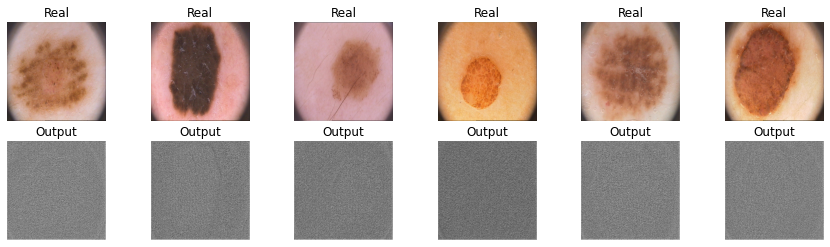

* Epoch 2/20
Train_loss: 0.326980, train_iou: 0.211458
Val_loss: 0.841213, val_iou: 0.000000


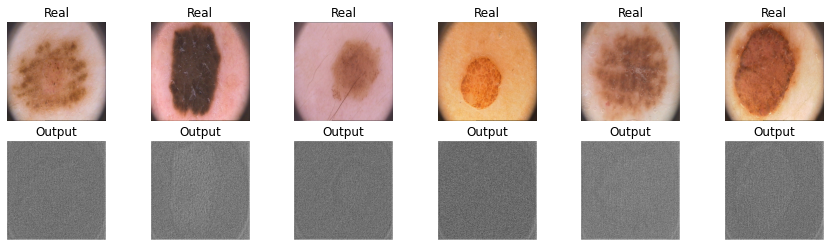

* Epoch 3/20
Train_loss: 0.232838, train_iou: 0.420833
Val_loss: 0.965159, val_iou: 0.000000


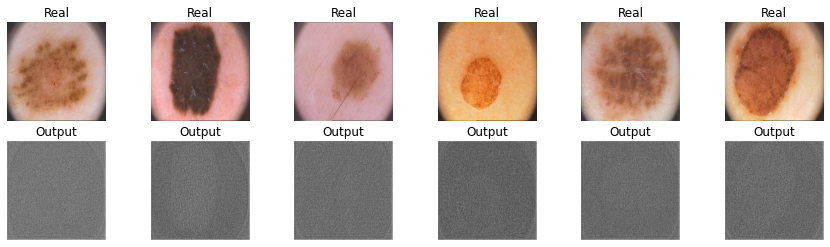

* Epoch 4/20
Train_loss: 0.176925, train_iou: 0.516667
Val_loss: 0.242971, val_iou: 0.391667


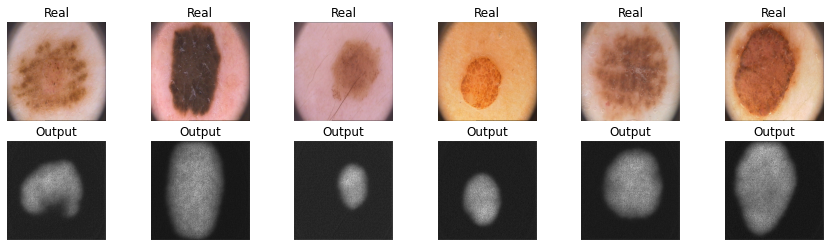

* Epoch 5/20
Train_loss: 0.206060, train_iou: 0.485417
Val_loss: 0.463824, val_iou: 0.104167


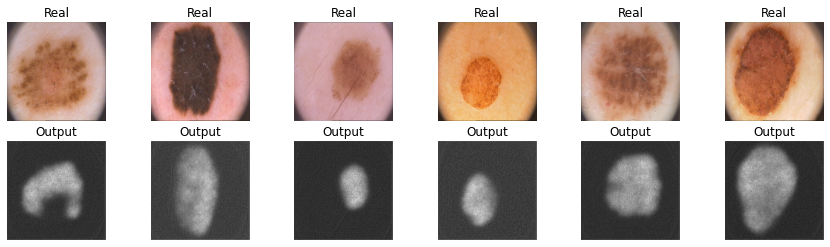

* Epoch 6/20
Train_loss: 0.150125, train_iou: 0.546875
Val_loss: 0.184162, val_iou: 0.504167


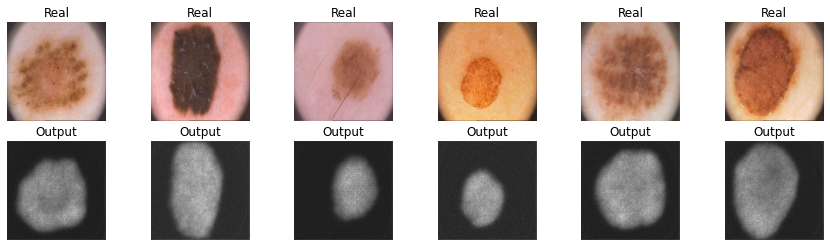

* Epoch 7/20
Train_loss: 0.128024, train_iou: 0.631250
Val_loss: 0.119843, val_iou: 0.625000


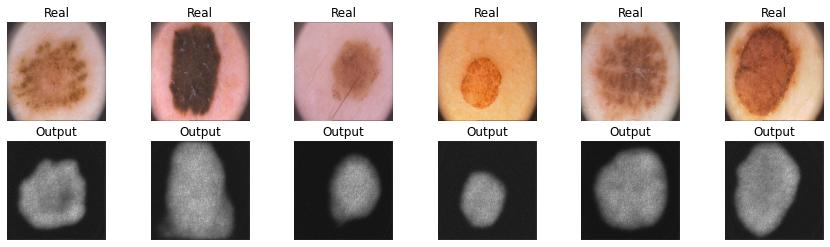

* Epoch 8/20
Train_loss: 0.111321, train_iou: 0.657292
Val_loss: 0.132125, val_iou: 0.612500


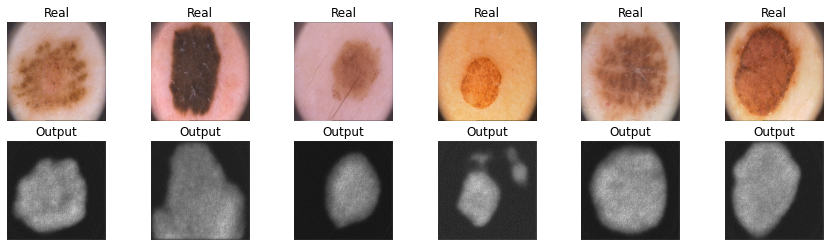

* Epoch 9/20
Train_loss: 0.122288, train_iou: 0.643750
Val_loss: 0.137990, val_iou: 0.562500


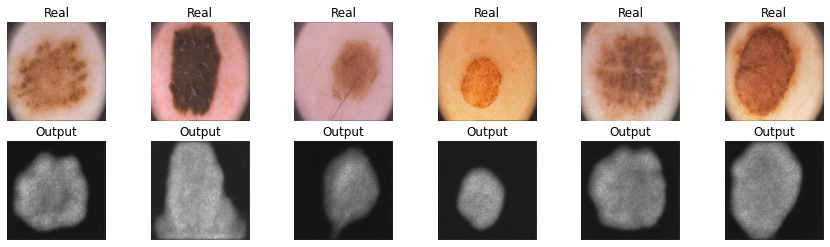

* Epoch 10/20
Train_loss: 0.116222, train_iou: 0.646875
Val_loss: 0.142398, val_iou: 0.568750


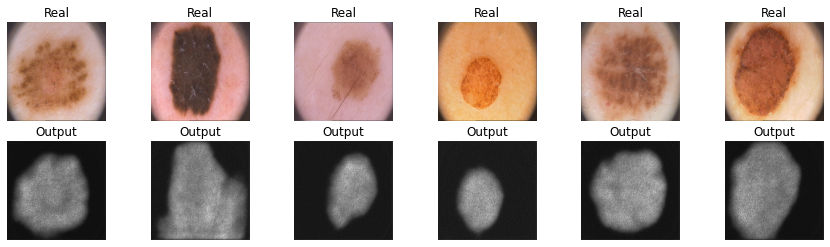

* Epoch 11/20
Train_loss: 0.118498, train_iou: 0.643750
Val_loss: 0.126215, val_iou: 0.591667


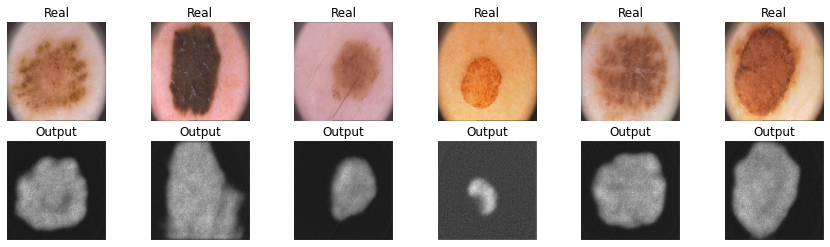

* Epoch 12/20
Train_loss: 0.096706, train_iou: 0.694792
Val_loss: 0.106220, val_iou: 0.675000


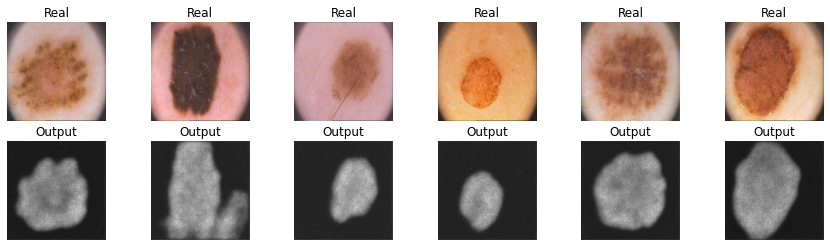

* Epoch 13/20
Train_loss: 0.112727, train_iou: 0.669792
Val_loss: 0.118127, val_iou: 0.604167


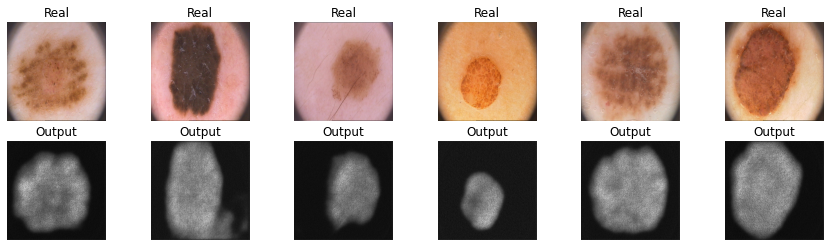

* Epoch 14/20
Train_loss: 0.109374, train_iou: 0.675000
Val_loss: 0.128169, val_iou: 0.614583


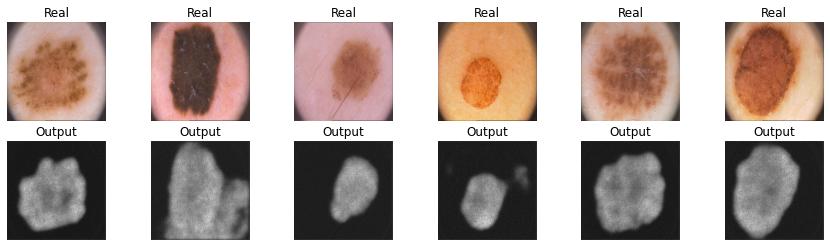

* Epoch 15/20
Train_loss: 0.092265, train_iou: 0.726042
Val_loss: 0.122239, val_iou: 0.602083


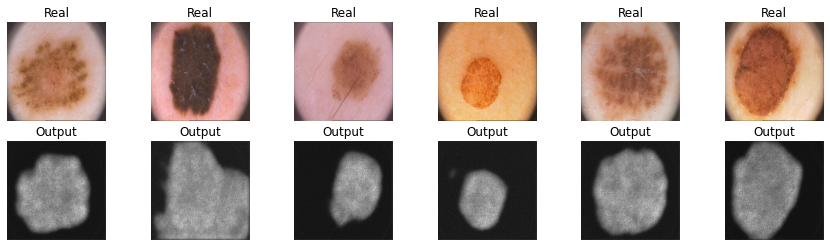

* Epoch 16/20
Train_loss: 0.093241, train_iou: 0.712500
Val_loss: 0.104286, val_iou: 0.654167


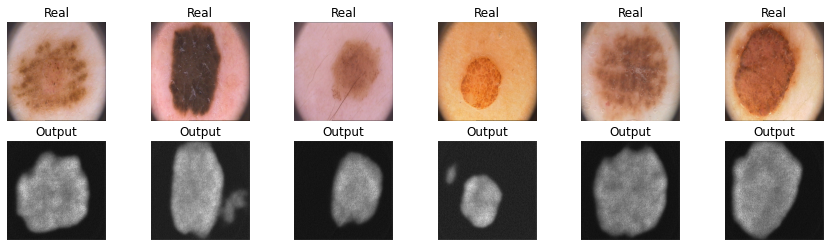

* Epoch 17/20
Train_loss: 0.112922, train_iou: 0.666667
Val_loss: 0.154095, val_iou: 0.520833


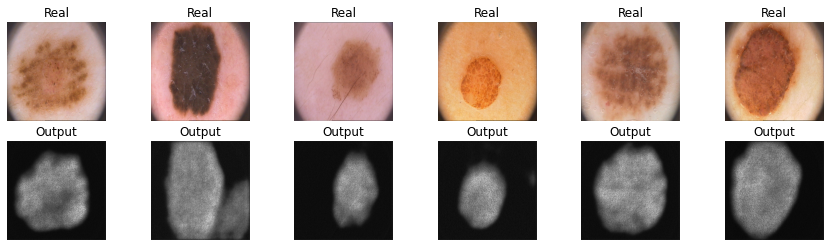

* Epoch 18/20
Train_loss: 0.085412, train_iou: 0.723958
Val_loss: 0.149767, val_iou: 0.587500


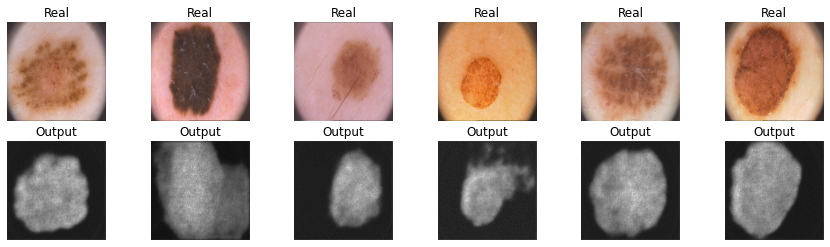

* Epoch 19/20
Train_loss: 0.077272, train_iou: 0.732292
Val_loss: 0.113888, val_iou: 0.635417


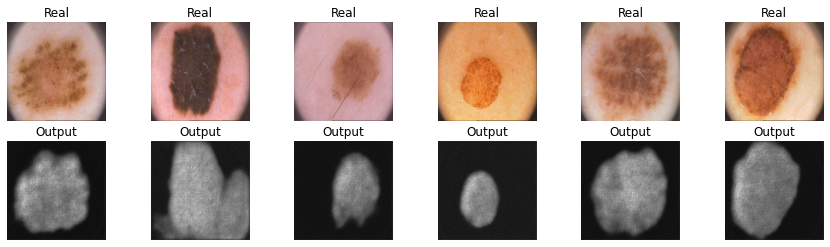

* Epoch 20/20
Train_loss: 0.080981, train_iou: 0.739583
Val_loss: 0.128066, val_iou: 0.654167


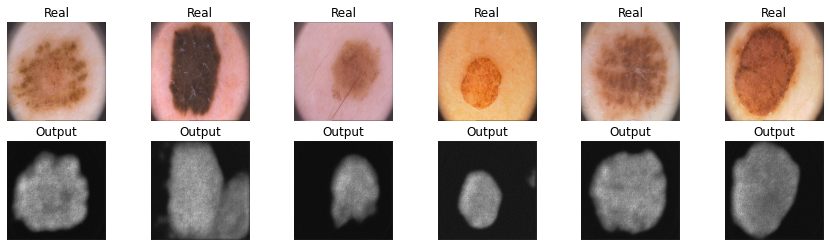

In [ ]:
epochs = 20

segnet_tversky = SegNet()

segnet_tversky_optimizer = torch.optim.Adam(segnet_tversky.parameters(),lr=0.00004)

history_segnet_tversky_loss = train(segnet_tversky, segnet_tversky_optimizer, tversky_loss, epochs, data_tr, data_val, iou_pytorch, device)

In [ ]:
score_model(segnet_tversky, iou_pytorch, data_ts)

tensor(0.7604, device='cuda:0')

-----------------------------------------------------------------------------------------

# U-Net [2 балла]

[**U-Net**](https://arxiv.org/abs/1505.04597) — это архитектура нейронной сети, которая получает изображение и выводит его. Первоначально он был задуман для семантической сегментации (как мы ее будем использовать), но он настолько успешен, что с тех пор используется в других контекстах. Получая на вход медицинское изображение, он выведет изображение в оттенках серого, где интенсивность каждого пикселя зависит от вероятности того, что этот пиксель принадлежит интересующей нас области.

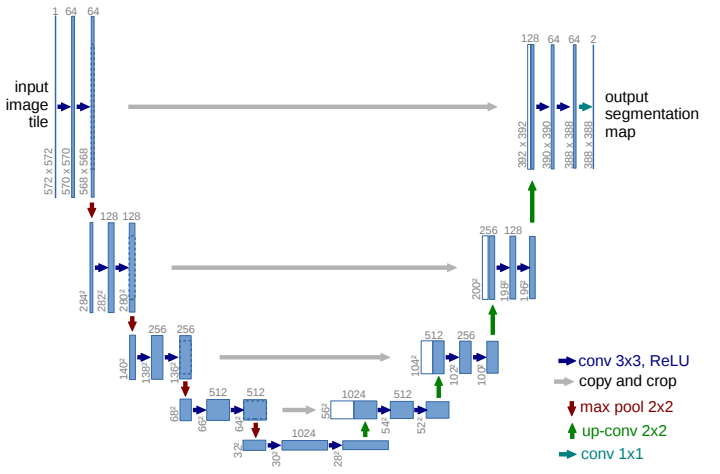

У нас в архитектуре все так же существует энкодер и декодер, как в **SegNet**, но отличительной особеностью данной модели являются *skip-conenctions*, соединяющие части декодера и энкодера. То есть для того чтобы передать на вход декодера тензор, мы конкатенируем симметричный выход с энкодера и выход предыдущего слоя декодера.

* Ronneberger, Olaf, Philipp Fischer, and Thomas Brox. "[U-Net: Convolutional networks for biomedical image segmentation.](https://arxiv.org/pdf/1505.04597.pdf)" International Conference on Medical image computing and computer-assisted intervention. Springer, Cham, 2015.

In [ ]:
class UNet(nn.Module):
    def __init__(self):
        super().__init__()

        self.enc_conv0 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU()
        )
        self.pool0 = nn.MaxPool2d(kernel_size=2, stride=2, padding=0)
        self.enc_conv1 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU()
        )
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2, padding=0)
        self.enc_conv2 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU()
        ) 
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2, padding=0)
        self.enc_conv3 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU()
        ) 
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2, padding=0)

        # bottleneck
        self.bottleneck_conv = nn.Sequential(
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU()
        ) 

        # decoder (upsampling)
        self.upsample0 = nn.UpsamplingNearest2d(scale_factor=2)
        self.dec_conv0 = nn.Sequential(
            nn.Conv2d(in_channels=1024, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU()
        ) 
        self.upsample1 = nn.UpsamplingNearest2d(scale_factor=2)
        self.dec_conv1 = nn.Sequential(
            nn.Conv2d(in_channels=512, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU()
        ) 
        self.upsample2 = nn.UpsamplingNearest2d(scale_factor=2)
        self.dec_conv2 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU()
        ) 
        self.upsample3 = nn.UpsamplingNearest2d(scale_factor=2)
        self.dec_conv3 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(in_channels=64, out_channels=1, kernel_size=1, padding=0),
        ) 
    
    def crop(self, enc, x):
        _, _, H, W = x.shape
        enc = torchvision.transforms.CenterCrop([H, W])(enc)
        return enc

    def forward(self, x):
        # encoder
        e0 = self.enc_conv0(x)
        e1 = self.enc_conv1(self.pool0(e0))
        e2 = self.enc_conv2(self.pool1(e1))
        e3 = self.enc_conv3(self.pool2(e2))

        # bottleneck
        b = self.bottleneck_conv(self.pool3(e3))

        # decoder
        u0 = self.upsample0(b)
        d0 = self.dec_conv0(torch.cat([u0, self.crop(e3, u0)], dim=1))
        u1 = self.upsample1(d0)
        d1 = self.dec_conv1(torch.cat([u1, self.crop(e2, u1)], dim=1))
        u2 = self.upsample2(d1)
        d2 = self.dec_conv2(torch.cat([u2, self.crop(e1, u2)], dim=1))
        u3 = self.upsample3(d2)
        d3 = self.dec_conv3(torch.cat([u3, self.crop(e0, u3)], dim=1))
        return d3

* Epoch 1/20
Train_loss: 0.494992, train_iou: 0.334375
Val_loss: 0.670750, val_iou: 0.000000


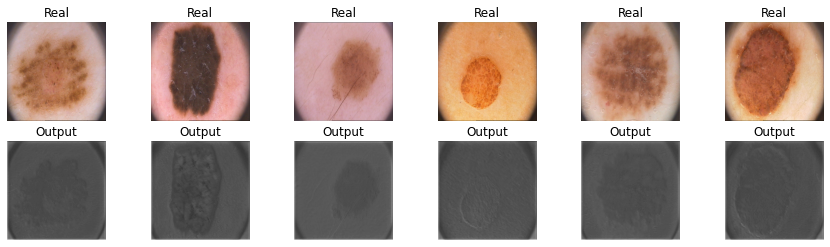

* Epoch 2/20
Train_loss: 0.373743, train_iou: 0.545833
Val_loss: 0.592390, val_iou: 0.000000


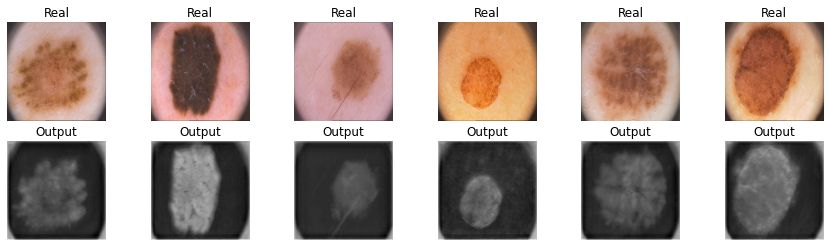

* Epoch 3/20
Train_loss: 0.331849, train_iou: 0.577083
Val_loss: 0.488571, val_iou: 0.066667


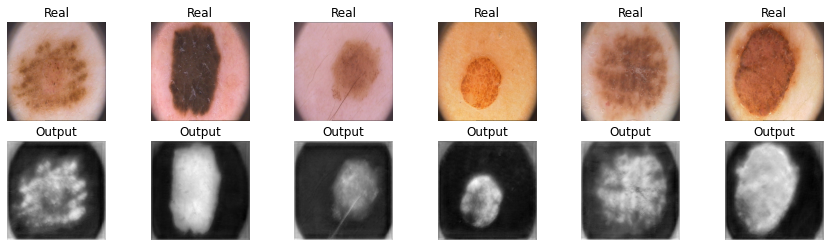

* Epoch 4/20
Train_loss: 0.314020, train_iou: 0.569792
Val_loss: 0.368070, val_iou: 0.456250


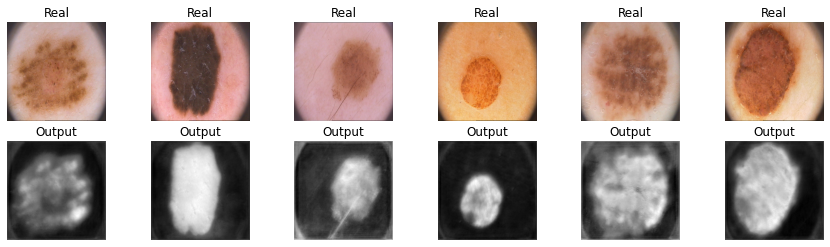

* Epoch 5/20
Train_loss: 0.293149, train_iou: 0.665625
Val_loss: 0.271819, val_iou: 0.664583


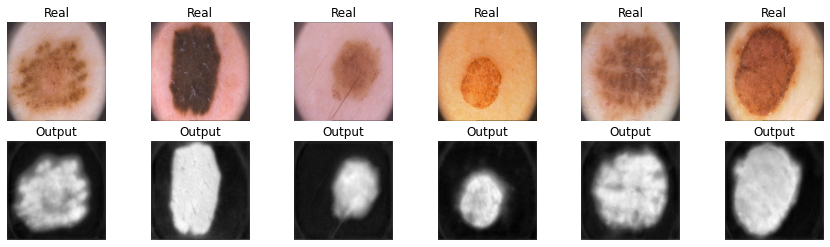

* Epoch 6/20
Train_loss: 0.284811, train_iou: 0.654167
Val_loss: 0.258225, val_iou: 0.668750


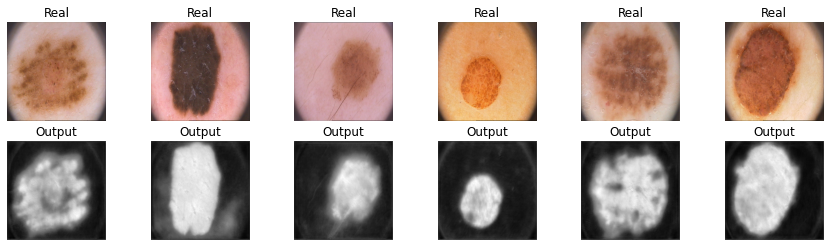

* Epoch 7/20
Train_loss: 0.277623, train_iou: 0.668750
Val_loss: 0.243065, val_iou: 0.689583


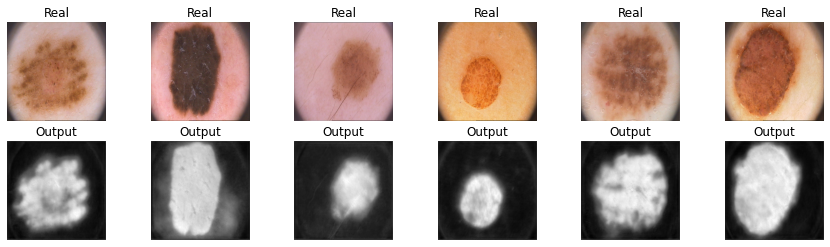

* Epoch 8/20
Train_loss: 0.270188, train_iou: 0.696875
Val_loss: 0.265290, val_iou: 0.650000


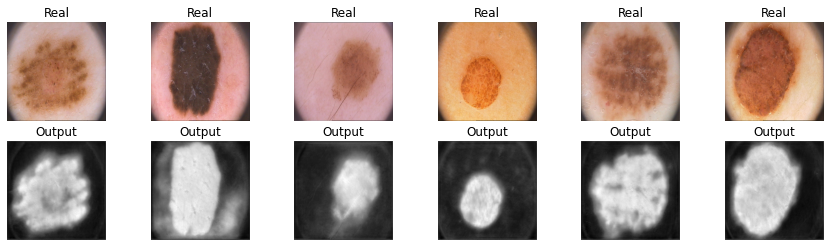

* Epoch 9/20
Train_loss: 0.261702, train_iou: 0.665625
Val_loss: 0.259128, val_iou: 0.666667


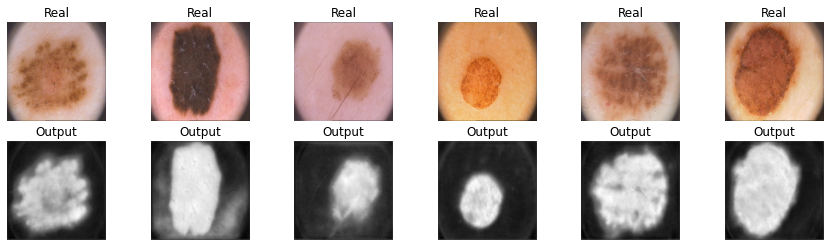

* Epoch 10/20
Train_loss: 0.263518, train_iou: 0.711458
Val_loss: 0.259454, val_iou: 0.712500


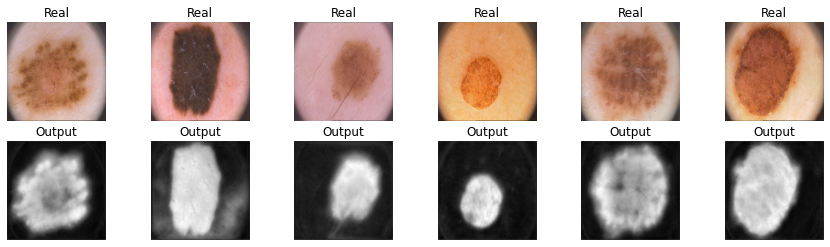

* Epoch 11/20
Train_loss: 0.252317, train_iou: 0.693750
Val_loss: 0.261612, val_iou: 0.650000


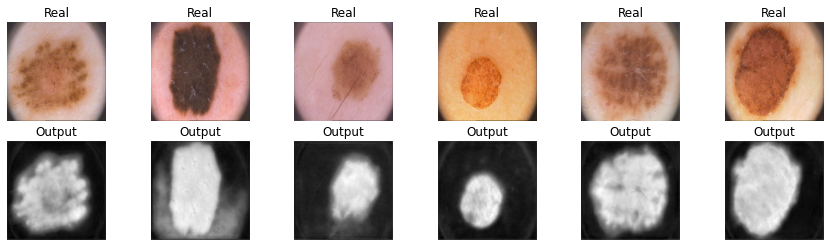

* Epoch 12/20
Train_loss: 0.241275, train_iou: 0.726042
Val_loss: 0.233406, val_iou: 0.697917


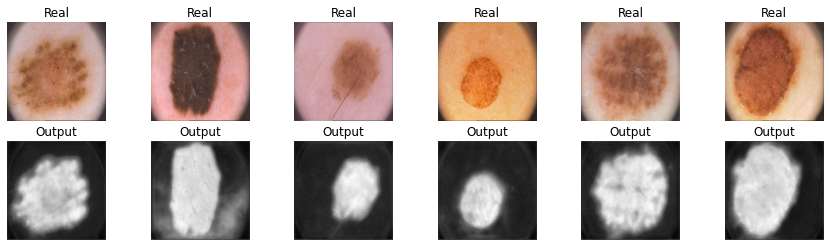

* Epoch 13/20
Train_loss: 0.231652, train_iou: 0.741667
Val_loss: 0.274532, val_iou: 0.652083


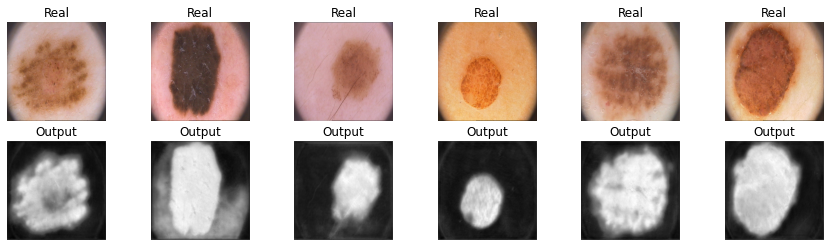

* Epoch 14/20
Train_loss: 0.229498, train_iou: 0.725000
Val_loss: 0.251356, val_iou: 0.658333


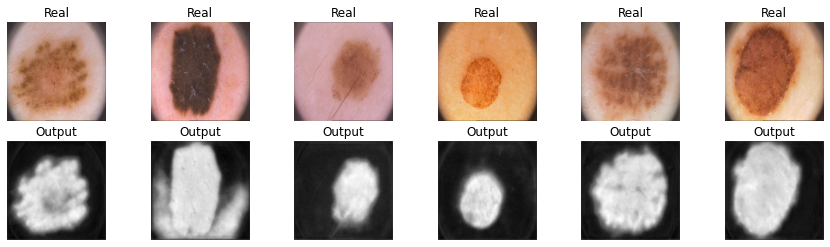

* Epoch 15/20
Train_loss: 0.242041, train_iou: 0.702083
Val_loss: 0.226246, val_iou: 0.737500


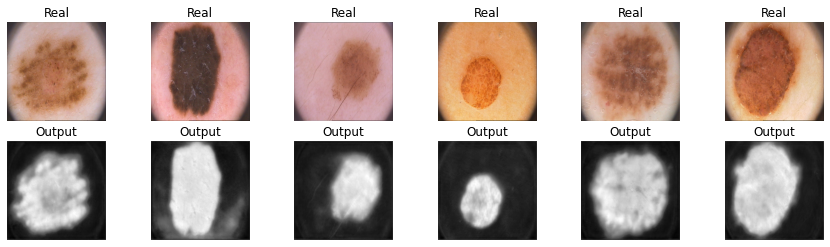

* Epoch 16/20
Train_loss: 0.219179, train_iou: 0.753125
Val_loss: 0.251938, val_iou: 0.654167


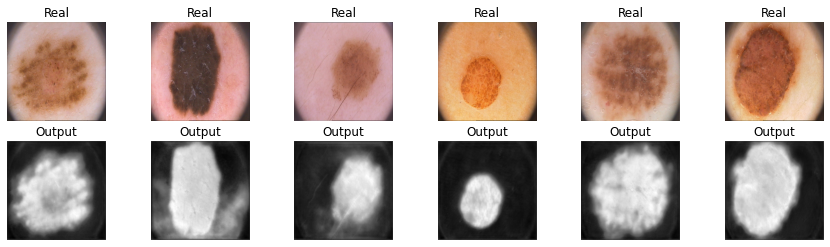

* Epoch 17/20
Train_loss: 0.221700, train_iou: 0.772917
Val_loss: 0.263641, val_iou: 0.666667


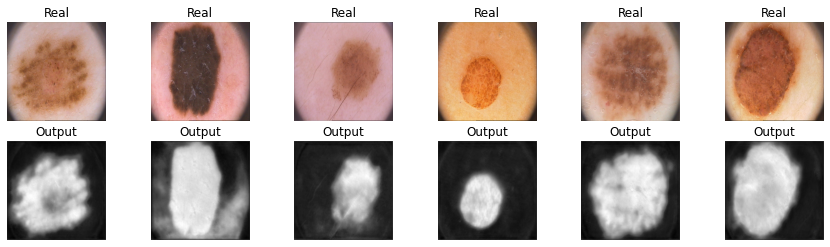

* Epoch 18/20
Train_loss: 0.208756, train_iou: 0.786458
Val_loss: 0.264345, val_iou: 0.641667


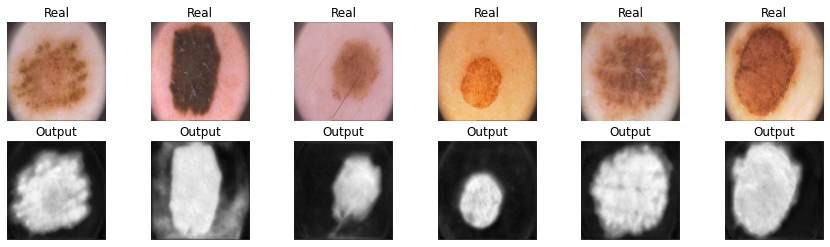

* Epoch 19/20
Train_loss: 0.205502, train_iou: 0.786458
Val_loss: 0.210014, val_iou: 0.752083


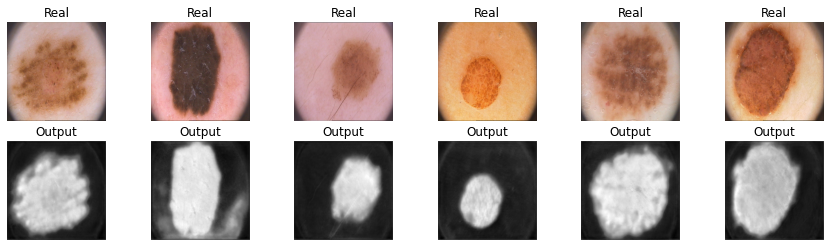

* Epoch 20/20
Train_loss: 0.203966, train_iou: 0.787500
Val_loss: 0.223565, val_iou: 0.720833


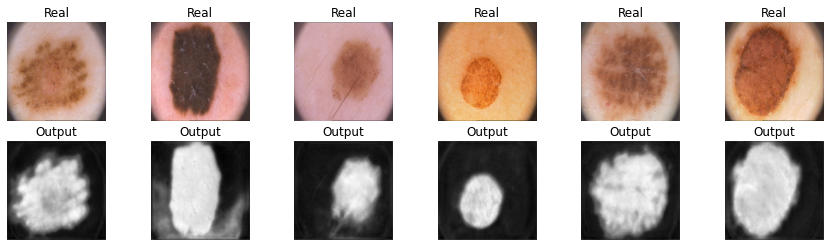

In [ ]:
epochs = 20

unet = UNet()

unet_optimizer = torch.optim.Adam(unet.parameters(),lr=0.00004)

history_unet = train(unet, unet_optimizer, bce_loss, epochs, data_tr, data_val, iou_pytorch, device)

In [ ]:
score_model(unet, iou_pytorch, data_val)

tensor(0.7208, device='cuda:0')

Новая модель путем изменения типа пулинга:

 **Max-Pooling** for the downsampling and **nearest-neighbor Upsampling** for the upsampling.

Down-sampling:

        conv = nn.Conv2d(3, 64, 3, padding=1)
        pool = nn.MaxPool2d(3, 2, padding=1)

Up-Sampling

        upsample = nn.Upsample(32)
        conv = nn.Conv2d(64, 64, 3, padding=1)

Замените max-pooling на convolutions с stride=2 и upsampling на transpose-convolutions с stride=2.


In [ ]:
class UNet2(nn.Module):
    def __init__(self):
        super().__init__()

        self.enc_conv0 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU()
        )
        self.pool0 = nn.Conv2d(in_channels=64, out_channels=64, kernel_size=2, stride=2, padding=0)
        self.enc_conv1 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU()
        )
        self.pool1 = nn.Conv2d(in_channels=128, out_channels=128, kernel_size=2, stride=2, padding=0)
        self.enc_conv2 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU()
        ) 
        self.pool2 = nn.Conv2d(in_channels=256, out_channels=256, kernel_size=2, stride=2, padding=0)
        self.enc_conv3 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU()
        ) 
        self.pool3 = nn.Conv2d(in_channels=512, out_channels=512, kernel_size=2, stride=2, padding=0)

        # bottleneck
        self.bottleneck_conv = nn.Sequential(
            nn.Conv2d(in_channels=512, out_channels=1024, kernel_size=3, padding=1),
            nn.BatchNorm2d(1024),
            nn.ReLU(),
            nn.Conv2d(in_channels=1024, out_channels=1024, kernel_size=3, padding=1),
            nn.BatchNorm2d(1024),
            nn.ReLU()
        ) 

        # decoder (upsampling)
        self.upsample0 = nn.ConvTranspose2d(1024 , 512, kernel_size=2, stride=2)
        self.dec_conv0 = nn.Sequential(
            nn.Conv2d(in_channels=1024, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU()
        ) 
        self.upsample1 = nn.ConvTranspose2d(512 , 256, kernel_size=2, stride=2)
        self.dec_conv1 = nn.Sequential(
            nn.Conv2d(in_channels=512, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU()
        ) 
        self.upsample2 = nn.ConvTranspose2d(256 , 128, kernel_size=2, stride=2)
        self.dec_conv2 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU()
        ) 
        self.upsample3 = nn.ConvTranspose2d(128 , 64, kernel_size=2, stride=2)
        self.dec_conv3 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(in_channels=64, out_channels=1, kernel_size=1, padding=0),
        ) 
    
    def crop(self, enc, x):
        _, _, H, W = x.shape
        enc = torchvision.transforms.CenterCrop([H, W])(enc)
        return enc

    def forward(self, x):
        # encoder
        e0 = self.enc_conv0(x)
        e1 = self.enc_conv1(self.pool0(e0))
        e2 = self.enc_conv2(self.pool1(e1))
        e3 = self.enc_conv3(self.pool2(e2))

        # bottleneck
        b = self.bottleneck_conv(self.pool3(e3))

        # decoder
        u0 = self.upsample0(b)
        d0 = self.dec_conv0(torch.cat([u0, self.crop(e3, u0)], dim=1))
        u1 = self.upsample1(d0)
        d1 = self.dec_conv1(torch.cat([u1, self.crop(e2, u1)], dim=1))
        u2 = self.upsample2(d1)
        d2 = self.dec_conv2(torch.cat([u2, self.crop(e1, u2)], dim=1))
        u3 = self.upsample3(d2)
        d3 = self.dec_conv3(torch.cat([u3, self.crop(e0, u3)], dim=1))
        return d3

* Epoch 1/20
Train_loss: 0.595474, train_iou: 0.154167
Val_loss: 0.690878, val_iou: 0.020833


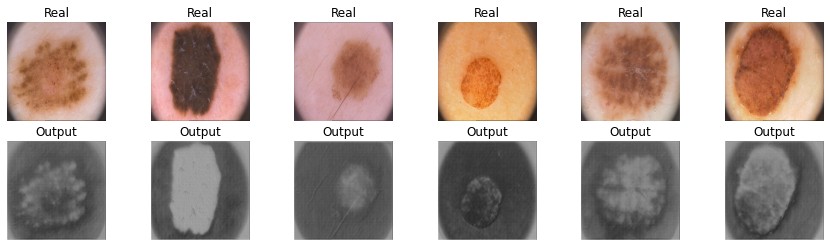

* Epoch 2/20
Train_loss: 0.463574, train_iou: 0.270833
Val_loss: 0.626539, val_iou: 0.081250


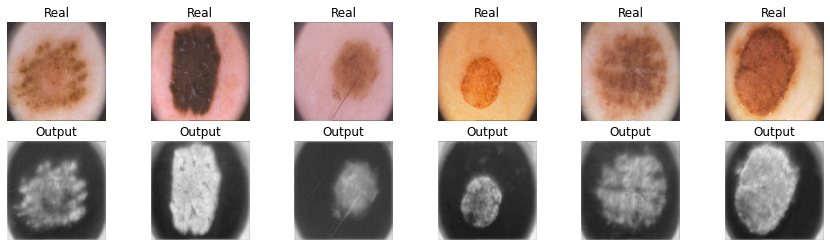

* Epoch 3/20
Train_loss: 0.392688, train_iou: 0.495833
Val_loss: 0.504145, val_iou: 0.110417


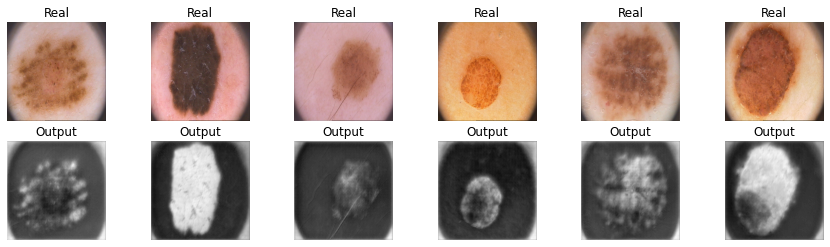

* Epoch 4/20
Train_loss: 0.347740, train_iou: 0.593750
Val_loss: 0.375303, val_iou: 0.354167


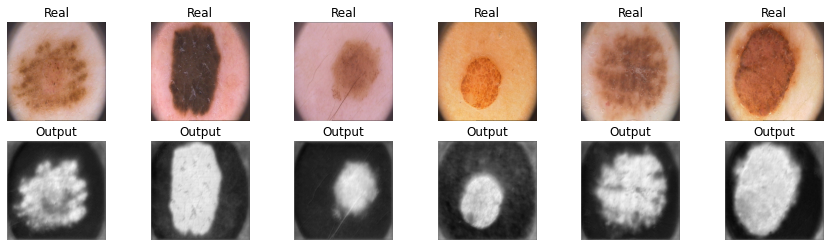

* Epoch 5/20
Train_loss: 0.319043, train_iou: 0.608333
Val_loss: 0.300160, val_iou: 0.602083


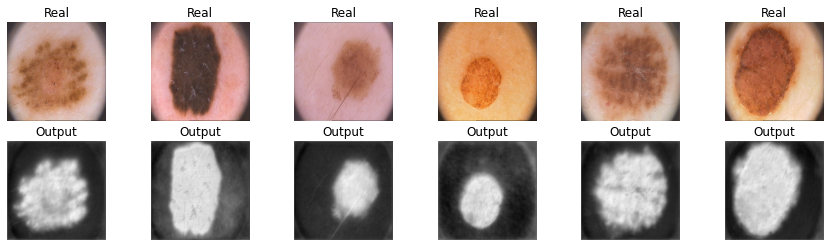

* Epoch 6/20
Train_loss: 0.318821, train_iou: 0.608333
Val_loss: 0.301408, val_iou: 0.622917


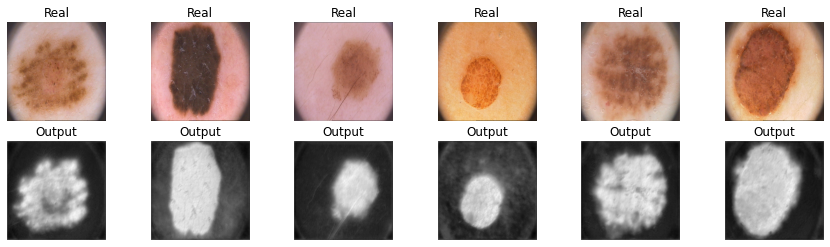

* Epoch 7/20
Train_loss: 0.289721, train_iou: 0.655208
Val_loss: 0.266210, val_iou: 0.639583


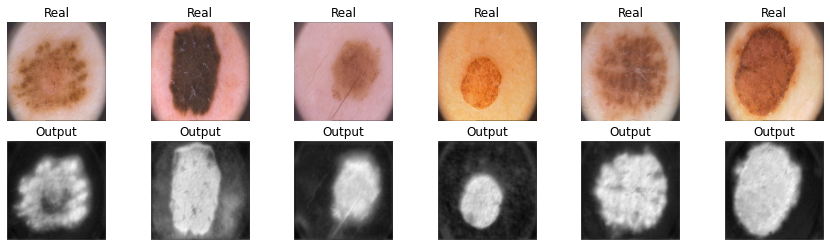

* Epoch 8/20
Train_loss: 0.286879, train_iou: 0.629167
Val_loss: 0.275778, val_iou: 0.610417


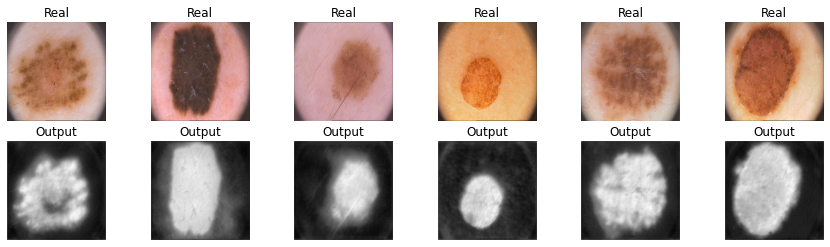

* Epoch 9/20
Train_loss: 0.278656, train_iou: 0.630208
Val_loss: 0.304350, val_iou: 0.539583


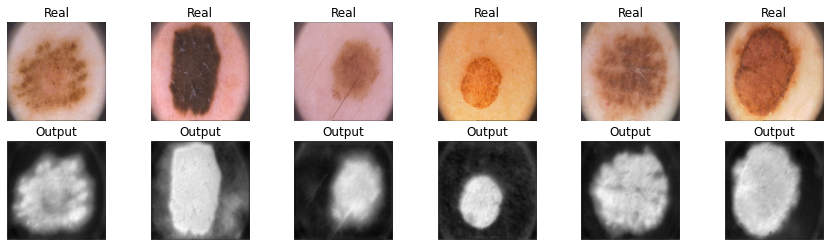

* Epoch 10/20
Train_loss: 0.288101, train_iou: 0.653125
Val_loss: 0.260731, val_iou: 0.618750


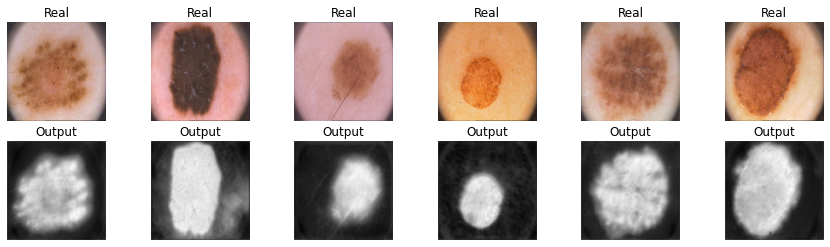

* Epoch 11/20
Train_loss: 0.245121, train_iou: 0.708333
Val_loss: 0.275203, val_iou: 0.618750


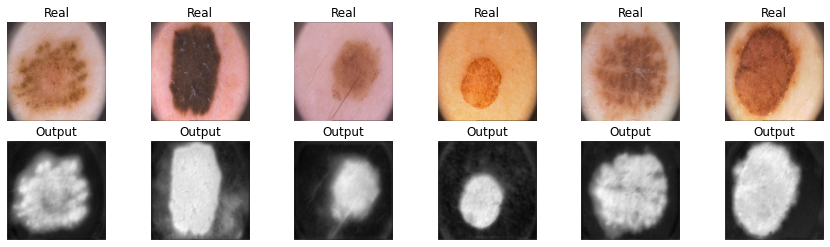

* Epoch 12/20
Train_loss: 0.262344, train_iou: 0.656250
Val_loss: 0.269551, val_iou: 0.658333


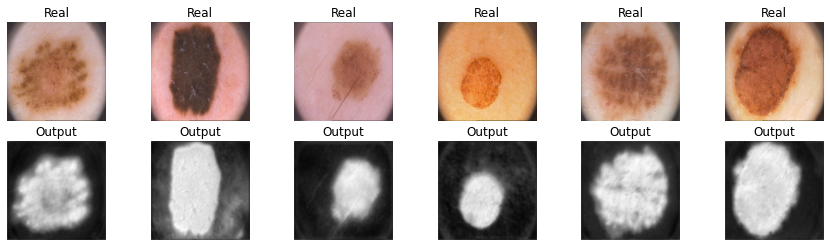

* Epoch 13/20
Train_loss: 0.247549, train_iou: 0.716667
Val_loss: 0.229640, val_iou: 0.677083


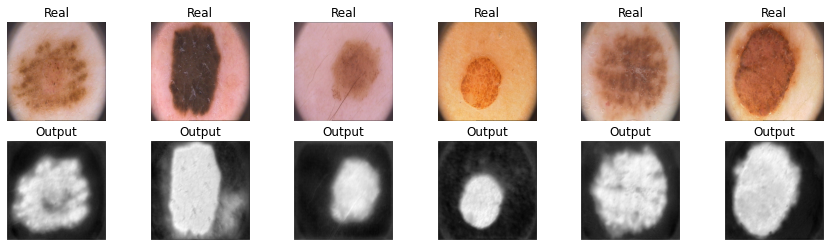

* Epoch 14/20
Train_loss: 0.240685, train_iou: 0.702083
Val_loss: 0.243307, val_iou: 0.643750


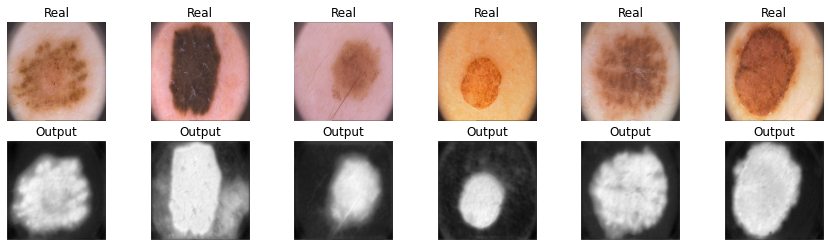

* Epoch 15/20
Train_loss: 0.246117, train_iou: 0.697917
Val_loss: 0.230867, val_iou: 0.708333


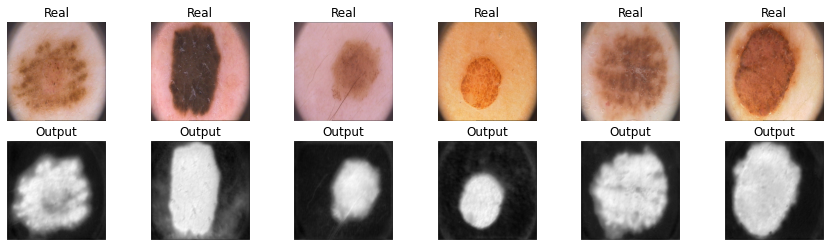

* Epoch 16/20
Train_loss: 0.228142, train_iou: 0.732292
Val_loss: 0.238627, val_iou: 0.672917


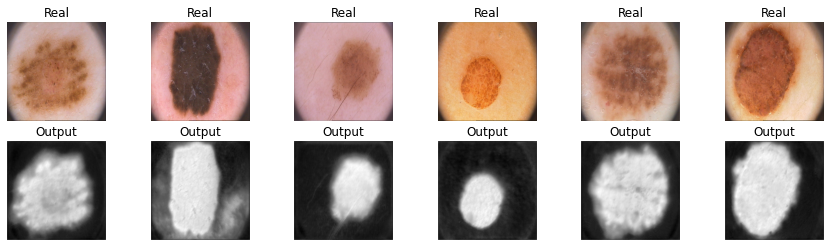

* Epoch 17/20
Train_loss: 0.231054, train_iou: 0.730208
Val_loss: 0.236396, val_iou: 0.675000


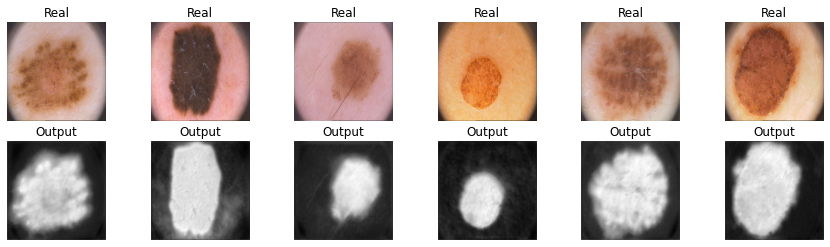

* Epoch 18/20
Train_loss: 0.239368, train_iou: 0.705208
Val_loss: 0.208622, val_iou: 0.679167


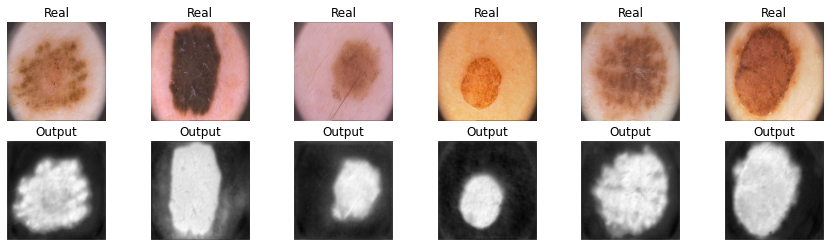

* Epoch 19/20
Train_loss: 0.233762, train_iou: 0.714583
Val_loss: 0.227095, val_iou: 0.693750


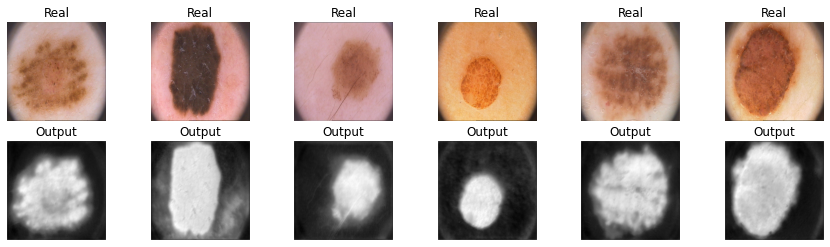

* Epoch 20/20
Train_loss: 0.216766, train_iou: 0.757292
Val_loss: 0.251222, val_iou: 0.658333


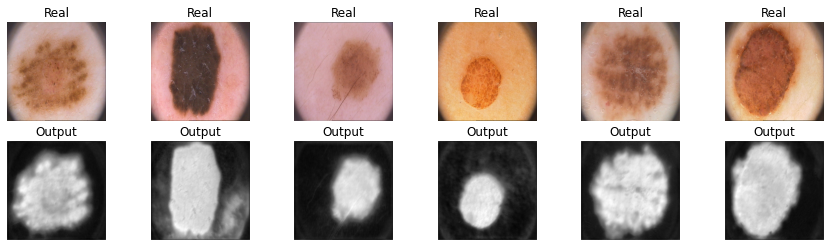

In [ ]:
epochs = 20

unet2 = UNet2()

unet2_optimizer = torch.optim.Adam(unet2.parameters(),lr=0.00004)

history_unet2 = train(unet2, unet2_optimizer, bce_loss, epochs, data_tr, data_val, iou_pytorch, device)

In [ ]:
score_model(unet2, iou_pytorch, data_val)

tensor(0.6583, device='cuda:0')

Сделайте вывод, какая из моделей лучше

# Отчет (6 баллов): 
Ниже предлагается написать отчет о проделанно работе и построить графики для лоссов, метрик на валидации и тесте. 
Если вы пропустили какую-то часть в задании выше, то вы все равно можете получить основную часть баллов в отчете, если правильно зададите проверяемые вами гипотезы.


Аккуратно сравните модели между собой и соберите наилучшую архитектуру. Проверьте каждую модель с различными лоссами. Мы не ограничиваем вас в формате отчета, но проверяющий должен отчетливо понять для чего построен каждый график, какие выводы вы из него сделали и какой общий вывод можно сделать на основании данных моделей. Если вы захотите добавить что-то еще, чтобы увеличить шансы получения максимального балла, то добавляйте отдельное сравнение.

Дополнительные комментарии: 

Пусть у вас есть N обученных моделей.
- Является ли отчетом N графиков с 1 линей? Да, но очень низкокачественным, потому что проверяющий не сможет сам сравнить их.

- Является ли отчетом 1 график с N линиями? Да, но скорее всего таким образом вы отразили лишь один эффект. Этого мало, чтобы сделать досточно суждений по поводу вашей работа.

- Я проверял метрики на трейне, и привел в результате таблицу с N числами, что не так? ключейвой момент тут, что вы измеряли на трейне ваши метрики, уверены ли вы, что заивисмости останутся такими же на отложенной выборке?

- Я сделал отчет содержащий график лоссов и метрик, и у меня нет ошибок в основной части, но за отчет не стоит максимум, почему? Естестественно максимум баллов за отчет можно получить не за 2 графика (даже при условии их полной правильности). Проверяющий хочет видеть больше сравнений моделей, чем метрики и лоссы (особенно, если они на трейне).

Советы: попробуйте правильно поставить вопрос на который вы себе отвечаете и продемонстрировать таблицу/график, помогающий проверяющему увидеть ответ на этот вопрос. Пример: Ваня хочет узнать, с каким из 4-х лоссов модель (например, U-Net) имеет наилучшее качество. Что нужно сделать Ване? Обучить 4 одинаковых модели с разными лосс функциями. И измерить итогововое качество. Продемонстрировать результаты своих измерений и итоговый вывод. (warning: конечно же, это не идеально ответит на наш вопрос, так как мы не учитываем в экспериментах возможные различные типы ошибок, но для первого приближения этого вполне достаточно).

Примерное время на подготовку отчета 1 час, он содержит сравнеение метрик, график лоссов, выбор лучших моделей из нескольких кластеров и выбор просто лучшей модели, небольшой вывод по всему дз, возможно сравнение результирующих сегментаций, времени или числа параметров модели, проявляйте креативность.

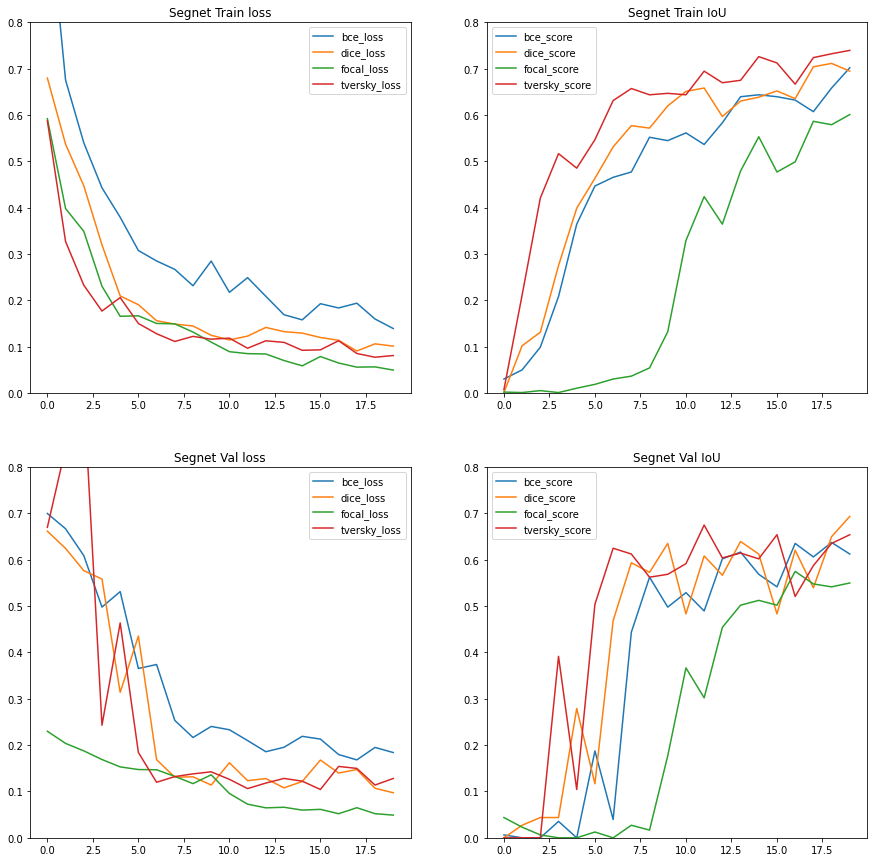

In [ ]:
bce_loss_train, bce_score_train, bce_loss_val, bce_score_val = zip(*history_segnet_bce_loss)
dice_loss_train, dice_score_train, dice_loss_val, dice_score_val = zip(*history_segnet_dice_loss)
focal_loss_train, focal_score_train, focal_loss_val, focal_score_val = zip(*history_segnet_focal_loss)
tversky_loss_train, tversky_score_train, tversky_loss_val, tversky_score_val = zip(*history_segnet_tversky_loss)


fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(15,15))
axes[0,0].set(title='Segnet Train loss')
axes[0,0].plot(bce_loss_train, label='bce_loss')
axes[0,0].plot(dice_loss_train, label='dice_loss')
axes[0,0].plot(focal_loss_train, label='focal_loss')
axes[0,0].plot(tversky_loss_train, label='tversky_loss')
axes[0,0].set_ylim(0.0, 0.8)
axes[0,0].legend()

axes[0,1].set(title='Segnet Train IoU')
axes[0,1].plot(bce_score_train, label='bce_score')
axes[0,1].plot(dice_score_train, label='dice_score')
axes[0,1].plot(focal_score_train, label='focal_score')
axes[0,1].plot(tversky_score_train, label='tversky_score')
axes[0,1].set_ylim(0.0, 0.8)
axes[0,1].legend()

axes[1,0].set(title='Segnet Val loss')
axes[1,0].plot(bce_loss_val, label='bce_loss')
axes[1,0].plot(dice_loss_val, label='dice_loss')
axes[1,0].plot(focal_loss_val, label='focal_loss')
axes[1,0].plot(tversky_loss_val, label='tversky_loss')
axes[1,0].set_ylim(0.0, 0.8)
axes[1,0].legend()

axes[1,1].set(title='Segnet Val IoU')
axes[1,1].plot(bce_score_val, label='bce_score')
axes[1,1].plot(dice_score_val, label='dice_score')
axes[1,1].plot(focal_score_val, label='focal_score')
axes[1,1].plot(tversky_score_val, label='tversky_score')
axes[1,1].set_ylim(0.0, 0.8)
axes[1,1].legend()

plt.show()

In [ ]:
print('Качество на тестовой выборке для segnet_bce:')
print(score_model(segnet_bce, iou_pytorch, data_ts))
print('Качество на тестовой выборке для segnet_dice:')
print(score_model(segnet_dice, iou_pytorch, data_ts))
print('Качество на тестовой выборке для segnet_focal:')
print(score_model(segnet_focal, iou_pytorch, data_ts))
print('Качество на тестовой выборке для segnet_tversky:')
print(score_model(segnet_tversky, iou_pytorch, data_ts))

Качество на тестовой выборке для segnet_bce:
tensor(0.7146, device='cuda:0')
Качество на тестовой выборке для segnet_dice:
tensor(0.7500, device='cuda:0')
Качество на тестовой выборке для segnet_focal:
tensor(0.5688, device='cuda:0')
Качество на тестовой выборке для segnet_tversky:
tensor(0.7604, device='cuda:0')


Наилучшие результаты добились сети Segnet с использованием функций потерь dice и tversky, в этом можно убедиться проанализировав данные с графиков, а также результаты на тестовой выборке. 
BCE Loss в свою очередь не сильно отстал от лидеров по точность и возможно при более грамотном подборее гиперпараметров можнт сравниться с dice и tversky.
Наихудший результат получился с использованием focal loss

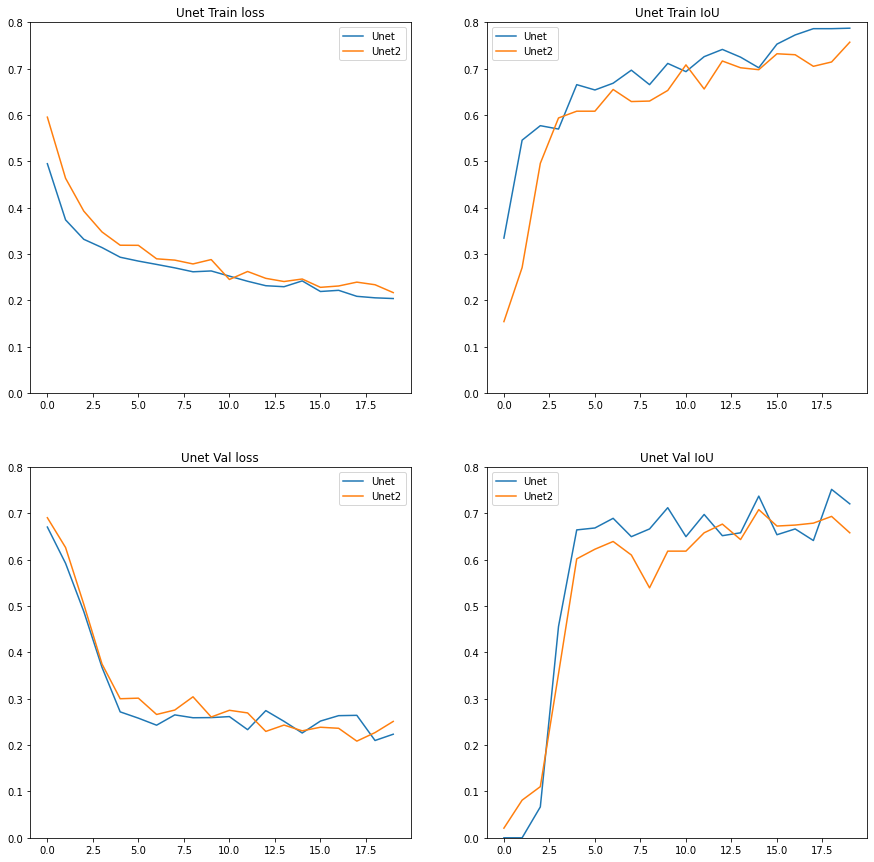

In [ ]:
unet_loss_train, unet_score_train, unet_loss_val, unet_score_val = zip(*history_unet)
unet2_loss_train, unet2_score_train, unet2_loss_val, unet2_score_val = zip(*history_unet2)


fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(15,15))
axes[0,0].set(title='Unet Train loss')
axes[0,0].plot(unet_loss_train, label='Unet')
axes[0,0].plot(unet2_loss_train, label='Unet2')
axes[0,0].set_ylim(0.0, 0.8)
axes[0,0].legend()

axes[0,1].set(title='Unet Train IoU')
axes[0,1].plot(unet_score_train, label='Unet')
axes[0,1].plot(unet2_score_train, label='Unet2')
axes[0,1].set_ylim(0.0, 0.8)
axes[0,1].legend()

axes[1,0].set(title='Unet Val loss')
axes[1,0].plot(unet_loss_val, label='Unet')
axes[1,0].plot(unet2_loss_val, label='Unet2')
axes[1,0].set_ylim(0.0, 0.8)
axes[1,0].legend()

axes[1,1].set(title='Unet Val IoU')
axes[1,1].plot(unet_score_val, label='Unet')
axes[1,1].plot(unet2_score_val, label='Unet2')
axes[1,1].set_ylim(0.0, 0.8)
axes[1,1].legend()

plt.show()

In [ ]:
print('Качество на тестовой выборке для Unet:')
print(score_model(unet, iou_pytorch, data_ts))
print('Качество на тестовой выборке для Unet2:')
print(score_model(unet2, iou_pytorch, data_ts))

Качество на тестовой выборке для Unet:
tensor(0.8104, device='cuda:0')
Качество на тестовой выборке для Unet2:
tensor(0.8063, device='cuda:0')


Среди различных версия Unet выделить явного победителя. Исходя из графиков и результатов на тестовой выборке модели выдают примерно одинаковые результаты. 
В тоже время они обучались с такими же параметрами, как и сети Segnet, где результат обучения сравнительно хуже.

Работу выполнил: Лазуков М.В.